# Signal-Processing-GEVD-DSS


##[Arya Kouresh)
)
### arya.koureshi@gmail.com

---


### Question 1

#### GEVD

##### part a

To solve part (a) using the Generalized Eigenvalue Decomposition (GEVD) method, we first need to understand the steps involved in this approach. GEVD is used in signal processing for blind source separation, where the aim is to separate a set of source signals from a set of mixed signals, without the aid of information (or with very little information) about the source signals or the mixing process.

Given the problem statement, we have an observation signal `x(t)` which is a linear combination of the effects of different sources `s_1(t), s_2(t), s_3(t)`, and other sources or noise. The challenge is to estimate the source `s_1(t)` which is an alternating triangular wave with a periodicity of 4 secondneeds to be modified.

In [1]:
#%% Question 1
#%% Imports
from scipy.io import loadmat
import numpy as np
import matplotlib.pyplot as plt
import scipy.io
import numpy as np
from sklearn.decomposition import FastICA
from scipy.linalg import eigh
import warnings
warnings.filterwarnings("ignore")

In [2]:
#%% part a
# Load Data
data = scipy.io.loadmat('C:/Users/aryak/Downloads/Comp_HW3/Q1.mat')

X_org = data['X_org']  # The observation signal
X_1 = data['X1'] 
X_2 = data['X2'] 
X_3 = data['X3'] 
X_4 = data['X4']

T_1 = data['T1'].flatten()
T_2 = data['T2'].flatten()

In [3]:
# GEVD function as defined previously
def GEVD(P, C):
    eigenvalues, eigenvectors = eigh(P, C)
    idx = np.argsort(eigenvalues)[::-1]
    eigenvalues = eigenvalues[idx]
    eigenvectors = eigenvectors[:, idx]
    return eigenvalues, eigenvectors

# Center the data by subtracting the mean
X_org_centered = X_org - np.mean(X_org, axis=1, keepdims=True)
# Estimate the cross-correlation matrix P_x for GEVD
P_x_gevd = np.dot(X_org_centered[:, :-400], X_org_centered[:, 400:].T) / (X_org.shape[1] - 400)
# Symmetrize P_x
P_x_hat_gevd = (P_x_gevd + P_x_gevd.T) / 2
# Estimate the covariance matrix C_x
C_x_gevd = np.cov(X_org)

# Perform GEVD
eigenvalues, eigenvectors = GEVD(P_x_hat_gevd, C_x_gevd)

# Extract the first eigenvector, corresponding to the highest eigenvalue
w = eigenvectors[:, 0]

# Calculate the estimated source and its effect on the observations
s_hat_1 = w.T @ X_org
x_hat_1 = np.outer(np.linalg.pinv(np.reshape(w, (1, len(w)))), s_hat_1)

# Calculate the error of the estimate
error = np.linalg.norm(X_1 - x_hat_1, 'fro') / np.linalg.norm(X_1, 'fro')

s_hat_1 = np.reshape(s_hat_1, (1, len(s_hat_1)))
# Return the estimated source, its effect on the observations and the error
s_hat_1, x_hat_1, error

(array([[ 0.35946624,  0.32964049,  0.12036285, ...,  0.78560816,
         -0.68492336,  0.12333462]]),
 array([[-0.02988863, -0.0274087 , -0.01000784, ..., -0.06532116,
          0.0569495 , -0.01025494],
        [-0.02711532, -0.0248655 , -0.00907923, ..., -0.05926014,
          0.05166526, -0.0093034 ],
        [ 0.02847867,  0.02611572,  0.00953573, ...,  0.0622397 ,
         -0.05426296,  0.00977117],
        ...,
        [ 0.01238797,  0.01136011,  0.00414796, ...,  0.02707372,
         -0.02360391,  0.00425037],
        [ 0.01761068,  0.01614948,  0.00589672, ...,  0.03848789,
         -0.03355522,  0.00604231],
        [ 0.02762442,  0.02533236,  0.0092497 , ...,  0.06037276,
         -0.0526353 ,  0.00947807]]),
 0.9618829663513159)

In [4]:
# Function to plot sources with names separately
def EEGplot(signal, method, fs=False, estimated=False):
    plt.figure(figsize=(21, 14))
    num_sources = signal.shape[0] 
    
    if method==False and estimated==False:
        plt.suptitle(f'Original Channels')
        max = 0
        min = 0
        for i in range(signal.shape[0]):
            mx = np.max(signal[i])
            mn = np.min(signal[i])
            if mx >= max: max = mx
            if mn <= min: min = mn
                
        for j in range(signal.shape[0]):
            plt.subplot(num_sources, 1, j + 1)
            plt.plot(np.arange(0, signal.shape[1]/fs, 1/fs), signal[j, :], label=f'Ch{j + 1}', c='k')
            if j+1 != signal.shape[0]:
                plt.xticks([])
            plt.ylabel(f'Ch{j + 1}', rotation=90)
            plt.tight_layout()
            plt.xlim([0, signal.shape[1]/fs])
            plt.ylim([min, max])
            plt.gca().yaxis.label.set(rotation='horizontal', ha='right', va='center');
            plt.gca().spines['top'].set_visible(False)
            plt.gca().spines['right'].set_visible(True)
            plt.gca().spines['bottom'].set_visible(False)
            plt.gca().spines['left'].set_visible(True)
        plt.xlabel("Time (sec)")
        
    if method==False and estimated==True:
        plt.suptitle(f'Estimated Channels')
        max = 0
        min = 0
        for i in range(signal.shape[0]):
            mx = np.max(signal[i])
            mn = np.min(signal[i])
            if mx >= max: max = mx
            if mn <= min: min = mn
                
        for j in range(signal.shape[0]):
            plt.subplot(num_sources, 1, j + 1)
            plt.plot(np.arange(0, signal.shape[1]/fs, 1/fs), signal[j, :], label=f'Ch{j + 1}', c='k')
            
            plt.ylabel(f'Ch{j + 1}', rotation=90)
            plt.tight_layout()
            plt.xlim([0, signal.shape[1]/fs])
            plt.ylim([min, max])
            plt.gca().yaxis.label.set(rotation='horizontal', ha='right', va='center');
            plt.gca().spines['top'].set_visible(False)
            plt.gca().spines['right'].set_visible(True)
            plt.gca().spines['bottom'].set_visible(False)
            plt.gca().spines['left'].set_visible(True)
        plt.xlabel("Time (sec)")
        
    elif method != False:
        colors = [
                    'b', 'g', 'r', 'c', 'm', 'y', 'k', 'pink',  # Standard colors: blue, green, red, cyan, magenta, yellow, black
                    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',  # Tableau Colors
                    '#1a1a1a', '#666666', '#a6a6a6', '#d9d9d9',  # Shades of gray
                    '#e41a1c', '#377eb8', '#4daf4a', '#ff7f00', '#ff33ff', '#ffff99', '#9966cc', '#ff6666', '#c2c2f0', '#ffb3e6',  # Additional colors
                ]
        plt.suptitle(f'Extracted Sources ({method})')
        for j in range(signal.shape[0]):
            plt.subplot(num_sources, 1, j + 1)
            plt.plot(np.arange(0, signal.shape[1]/fs, 1/fs), signal[j, :], label=f'S{j + 1}', c=colors[j])
            plt.yticks([])
            if j+1 != signal.shape[0]:
                plt.xticks([])
            plt.ylabel(f'S{j + 1}', rotation=90)
            plt.tight_layout()
            plt.xlim([0, signal.shape[1]/fs])
            plt.gca().yaxis.label.set(rotation='horizontal', ha='right', va='center');
            plt.gca().spines['top'].set_visible(False)
            plt.gca().spines['right'].set_visible(True)
            plt.gca().spines['bottom'].set_visible(False)
            plt.gca().spines['left'].set_visible(True)
        plt.xlabel("Time (sec)")
       
    plt.tight_layout()
    plt.show();


 ======================================================================================== X_org ========================================================================================



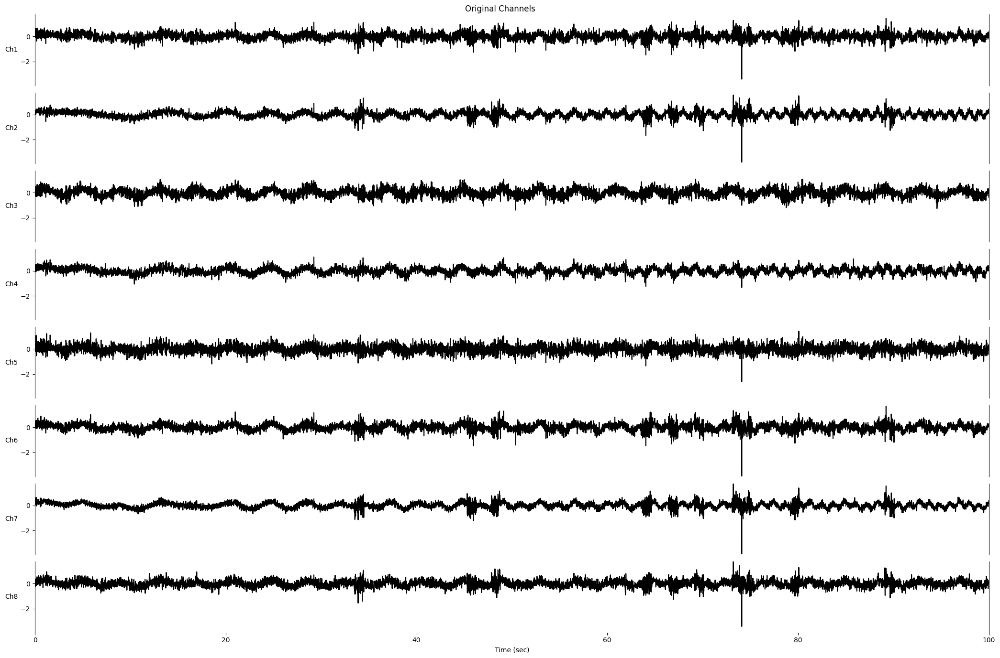


 ======================================================================================== X1 ========================================================================================



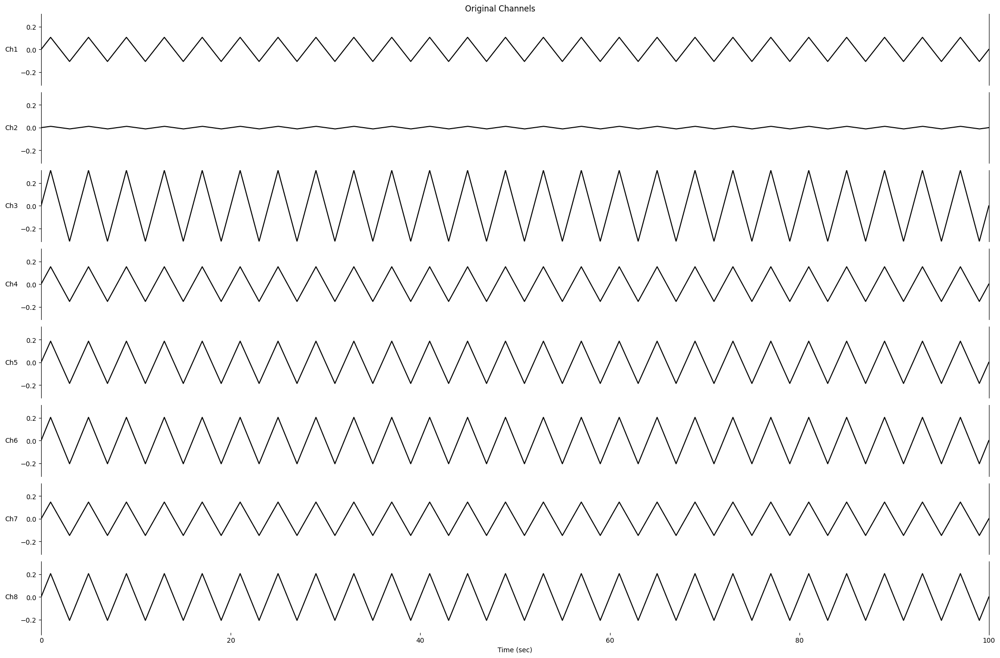


 ======================================================================================== X2 ========================================================================================



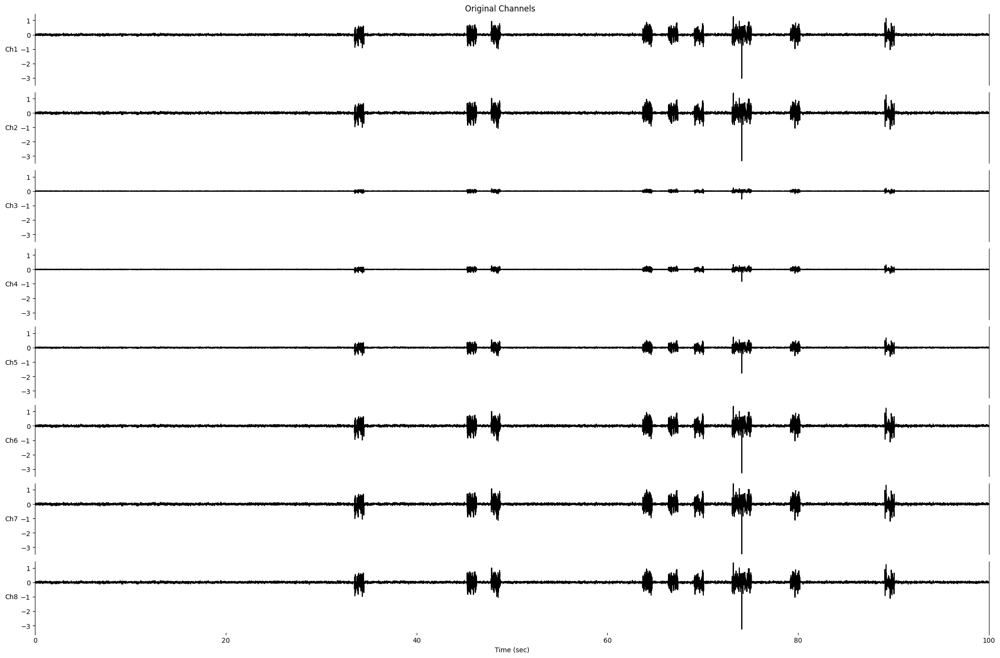


 ======================================================================================== X3 ========================================================================================



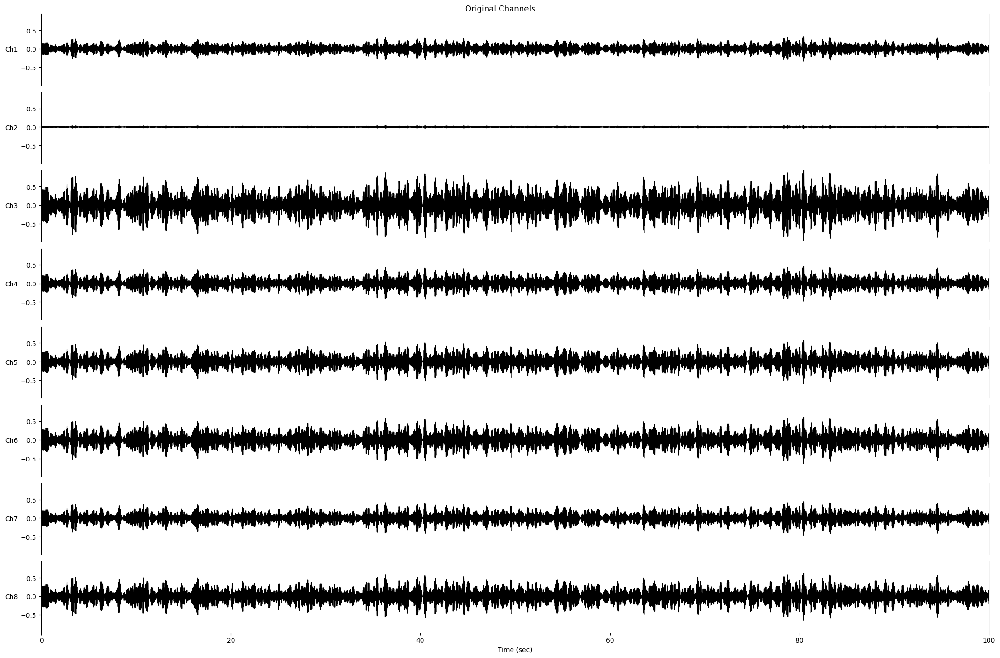


 ======================================================================================== X4 ========================================================================================



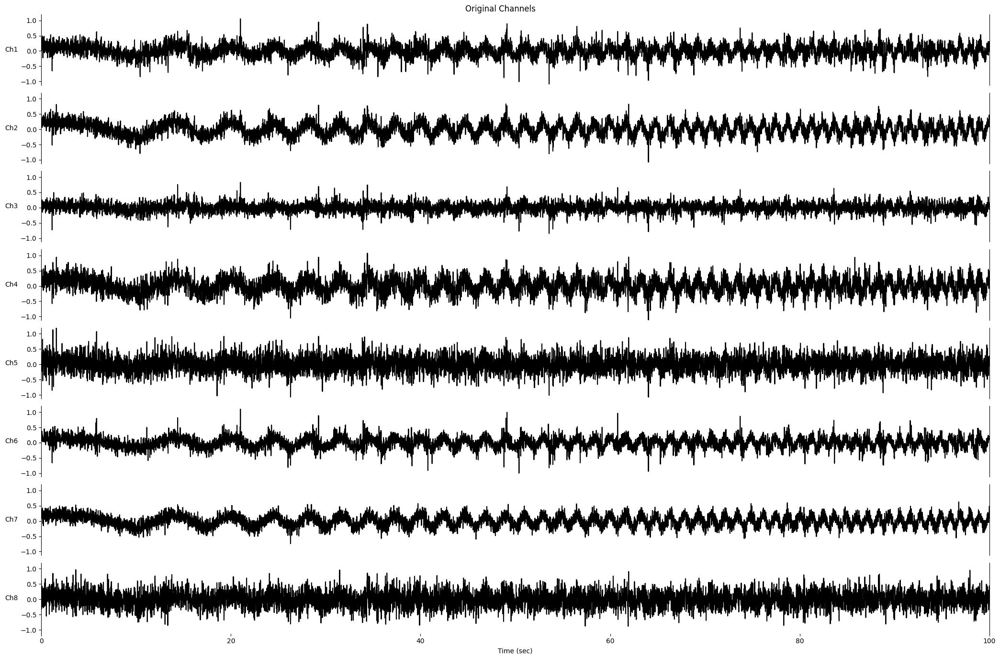

In [5]:
print("\n ======================================================================================== X_org ========================================================================================\n")
EEGplot(X_org, False, 100)
print("\n ======================================================================================== X1 ========================================================================================\n")
EEGplot(X_1, False, 100)
print("\n ======================================================================================== X2 ========================================================================================\n")
EEGplot(X_2, False, 100)
print("\n ======================================================================================== X3 ========================================================================================\n")
EEGplot(X_3, False, 100)
print("\n ======================================================================================== X4 ========================================================================================\n")
EEGplot(X_4, False, 100)


 ====================================================================================== X_1 Estimated ======================================================================================



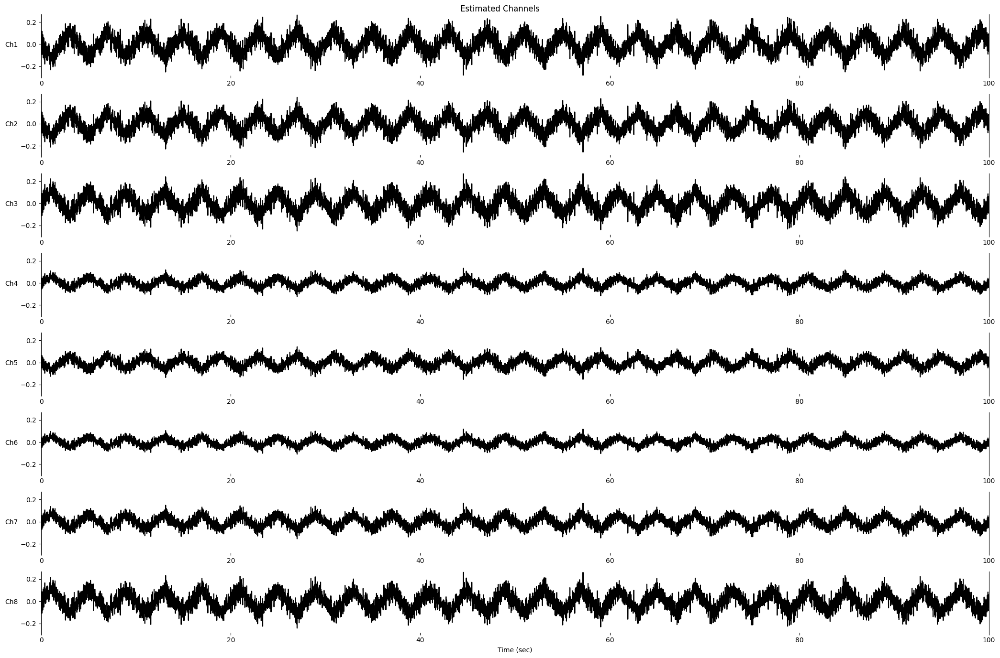


 ====================================================================================== S_1 Estimated ======================================================================================



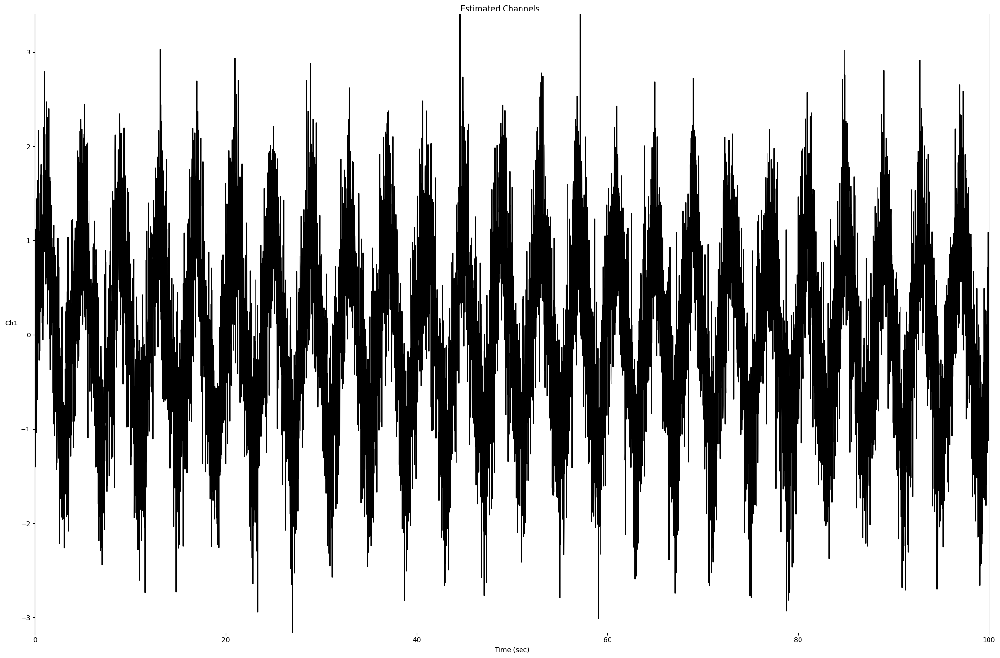

In [6]:
print("\n ====================================================================================== X_1 Estimated ======================================================================================\n")
EEGplot(x_hat_1, False, 100, estimated=True)
print("\n ====================================================================================== S_1 Estimated ======================================================================================\n")
EEGplot(s_hat_1, False, 100, estimated=True)


In [7]:
# Function to calculate RRMSE
def calculate_RRMSE(actual, estimated):
    rmse = np.sqrt(np.mean((actual - estimated) ** 2))
    rms_actual = np.sqrt(np.mean(actual ** 2))
    return rmse / rms_actual

# Calculate RRMSE for x_1(t)
rrmse_x_1 = calculate_RRMSE(X_1, x_hat_1)
rrmse_x_1


0.9618829663513161

---
##### part b

For Part B of the task, where the periodicity of the triangular wave is unknown but within the range of 3 to 7 seconds, we need to iterate over this range, apply GEVD, and select the best estimate based on some criteria, such as minimizing the error.

In [8]:
# Center the data
X_org_centered = X_org - np.mean(X_org, axis=1, keepdims=True)
C_x_gevd = np.cov(X_org)

# Iterate over possible periodicities (3 to 7 seconds)
sampling_rate = 100  # 100 Hz
min_period = 3 * sampling_rate  # 3 seconds
max_period = 7 * sampling_rate  # 7 seconds

best_period = min_period
lowest_error = np.inf

for period in range(min_period, max_period + 1):
    lag_samples = period
    P_x_gevd = np.dot(X_org_centered[:, :-lag_samples], X_org_centered[:, lag_samples:].T) / (X_org.shape[1] - lag_samples)
    P_x_hat_gevd = (P_x_gevd + P_x_gevd.T) / 2

    eigenvalues, eigenvectors = GEVD(P_x_hat_gevd, C_x_gevd)
    w = eigenvectors[:, 0]

    s_hat_1 = w.T @ X_org
    x_hat_1 = np.outer(np.linalg.pinv(np.reshape(w, (1, len(w)))), s_hat_1)

    error = calculate_RRMSE(X_1, x_hat_1)

    if error < lowest_error:
        lowest_error = error
        best_period = period
        best_s_hat_1 = s_hat_1
        best_x_hat_1 = x_hat_1

best_s_hat_1 = np.reshape(best_s_hat_1, (1, len(best_s_hat_1)))
# Results
best_period_seconds = best_period / sampling_rate
print("Best Periodicity (in seconds):", best_period_seconds)
print("Lowest Error:", lowest_error)

# best_s_hat_1 and best_x_hat_1 contain the best estimates


Best Periodicity (in seconds): 3.22
Lowest Error: 0.9592721045052566



 =================================================================================== Best X_1 Estimated ====================================================================================



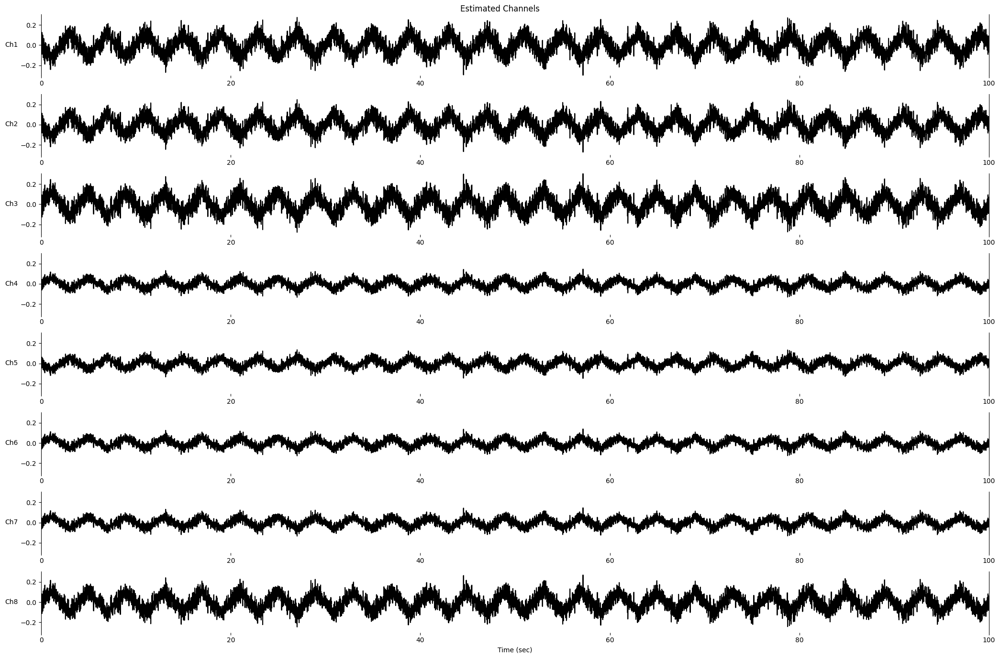


 =================================================================================== Best S_1 Estimated ====================================================================================



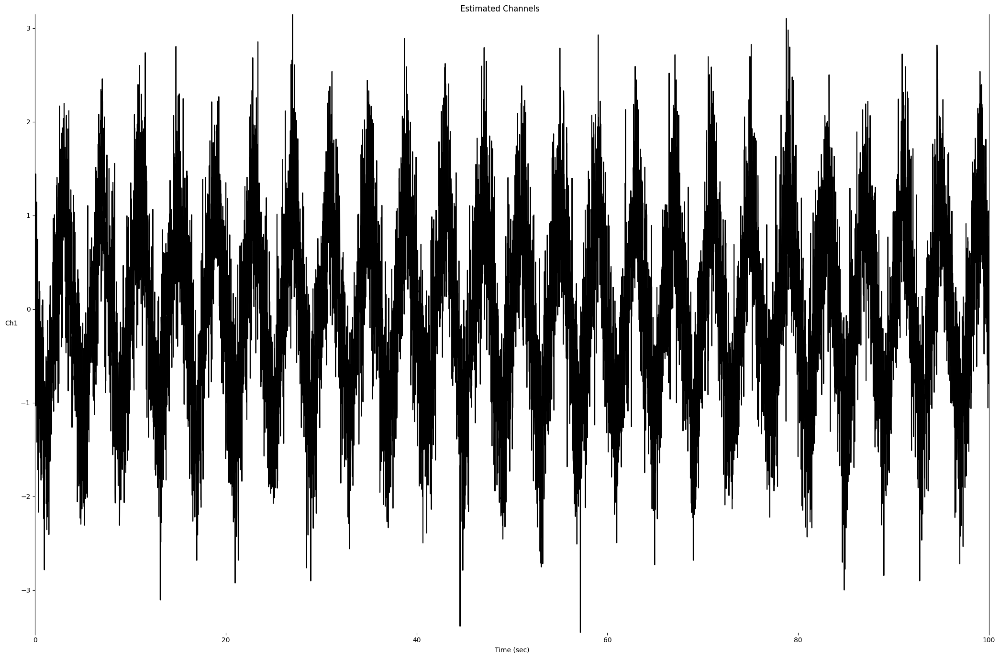

In [9]:
print("\n =================================================================================== Best X_1 Estimated ====================================================================================\n")
EEGplot(best_x_hat_1, False, 100, estimated=True)
print("\n =================================================================================== Best S_1 Estimated ====================================================================================\n")
EEGplot(best_s_hat_1, False, 100, estimated=True)

In this code, we iterate over the range of potential periodicities (3 to 7 seconds), applying GEVD for each and calculating the RRMSE to evaluate the performance. The periodicity with the lowest error is selected as the best estimate. Remember to verify the file paths and dependencies in our actual implementation.

---
##### part c

For part C, where we need to estimate the source \( s_2(t) \) (which is non-stationary and has on/off intervals as indicated by the vector \( T_1 \)), and its effect on the observations \( x_2(t) \), we can follow these steps:

1. **Use the on/off vector \( T_1 \)**: This vector indicates when the source \( s_2(t) \) is on or off. We'll use this to segregate the data into 'on' and 'off' periods.

2. **Calculate Separate Covariance Matrices for 'On' and 'Off' Periods**: By calculating covariance matrices for these periods, we can capture the variance in the signal during its active and inactive states.

3. **Apply GEVD**: Perform GEVD using these covariance matrices to extract the component associated with \( s_2(t) \).

4. **Estimate \( s_2(t) \) and \( x_2(t) \)**: Based on the eigenvector corresponding to the largest eigenvalue, estimate \( s_2(t) \) and its effect \( x_2(t) \).

5. **Calculate the Error**: As before, calculate the error of our estimate.

In [10]:
# Center the data
X_org_centered = X_org - np.mean(X_org, axis=1, keepdims=True)

# Covariance matrices for 'On' and 'Off' periods
C_x_on = np.cov(X_org_centered[:, T_1 == 1])
C_x_off = np.cov(X_org_centered[:, T_1 == 0])

# Perform GEVD
eigenvalues, eigenvectors = GEVD(C_x_on, C_x_off)
w = eigenvectors[:, 0]

# Estimate s_2(t) and its effect on observations x_2(t)
s_hat_2 = w.T @ X_org
x_hat_2 = np.outer(np.linalg.pinv(np.reshape(w, (1, len(w)))), s_hat_2)

# Calculate the error of the estimate
error_s2 = calculate_RRMSE(X_2, x_hat_2)

# Results
print("Error of the estimate for s_2(t):", error_s2)
s_hat_2 = np.reshape(s_hat_2, (1, len(s_hat_2)))
# s_hat_2 and x_hat_2 contain the estimates for s_2(t) and its effect

Error of the estimate for s_2(t): 0.919851124858283


This code will provide we with an estimate of \( s_2(t) \) and its effect on the observation signal \( x_2(t) \), along with the error of this estimate.


 ===================================================================================== X_2 Estimated ====================================================================================



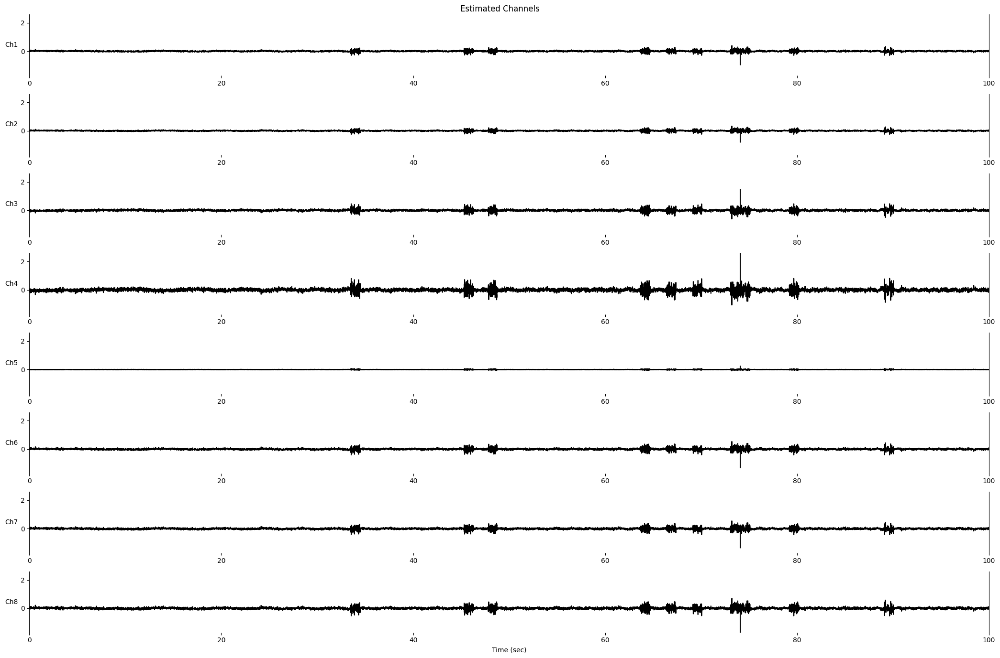


 ===================================================================================== S_2 Estimated ====================================================================================



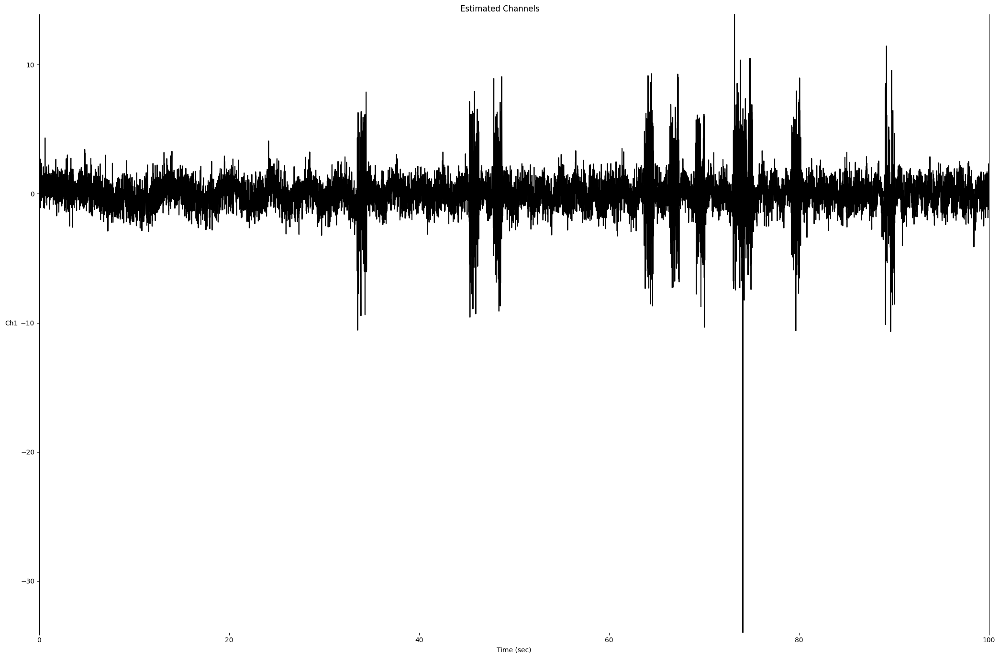

In [11]:
print("\n ===================================================================================== X_2 Estimated ====================================================================================\n")
EEGplot(x_hat_2, False, 100, estimated=True)
print("\n ===================================================================================== S_2 Estimated ====================================================================================\n")
EEGplot(s_hat_2, False, 100, estimated=True)

---
##### part d

For part D, where only some of the "on" times of the source \( s_2(t) \) are given (as indicated by the vector \( T_2 \)), the approach will be somewhat similar to part C, but with a focus on the partial information about the active periods. The steps are:

1. **Use the Partial On-Times Vector \( T_2 \)**: This vector indicates certain periods when the source \( s_2(t) \) is known to be on.

2. **Estimate Covariance Matrices for Partial 'On' Periods and Overall Signal**: Calculate the covariance matrix for the periods when \( s_2(t) \) is known to be on and for the entire observation signal.

3. **Apply GEVD**: Perform GEVD using these covariance matrices to extract the component associated with \( s_2(t) \).

4. **Estimate \( s_2(t) \) and \( x_2(t) \)**: Based on the eigenvector corresponding to the largest eigenvalue, estimate \( s_2(t) \) and its effect \( x_2(t) \).

5. **Calculate the Error**: As before, calculate the error of our estimate.

In [12]:
# Center the data
X_org_centered = X_org - np.mean(X_org, axis=1, keepdims=True)

# Covariance matrix for Partial 'On' periods and overall signal
C_x_partial_on = np.cov(X_org_centered[:, T_2 == 1])
C_x_total = np.cov(X_org_centered)

# Perform GEVD
eigenvalues, eigenvectors = GEVD(C_x_partial_on, C_x_total)
w = eigenvectors[:, 0]

# Estimate s_2(t) and its effect on observations x_2(t)
s_hat_2 = w.T @ X_org
x_hat_2 = np.outer(np.linalg.pinv(np.reshape(w, (1, len(w)))), s_hat_2)

# Calculate the error of the estimate
error_s2 = calculate_RRMSE(X_2, x_hat_2)

# Results
print("Error of the estimate for s_2(t):", error_s2)
s_hat_2 = np.reshape(s_hat_2, (1, len(s_hat_2)))
# s_hat_2 and x_hat_2 contain the estimates for s_2(t) and its effect

Error of the estimate for s_2(t): 0.9226657845728066



 ===================================================================================== X_2 Estimated ====================================================================================



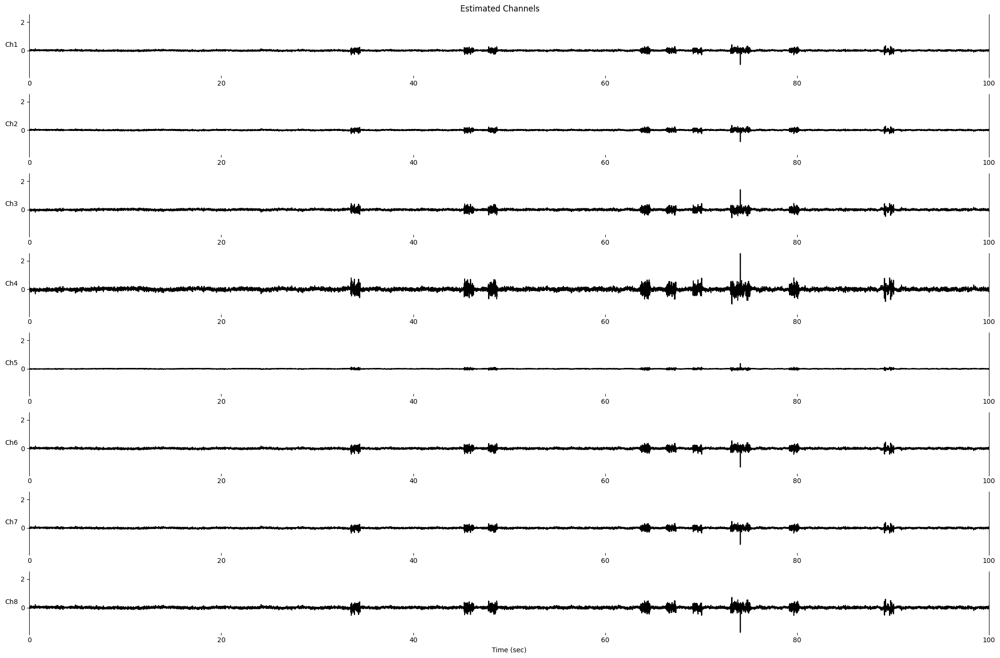


 ===================================================================================== S_2 Estimated ====================================================================================



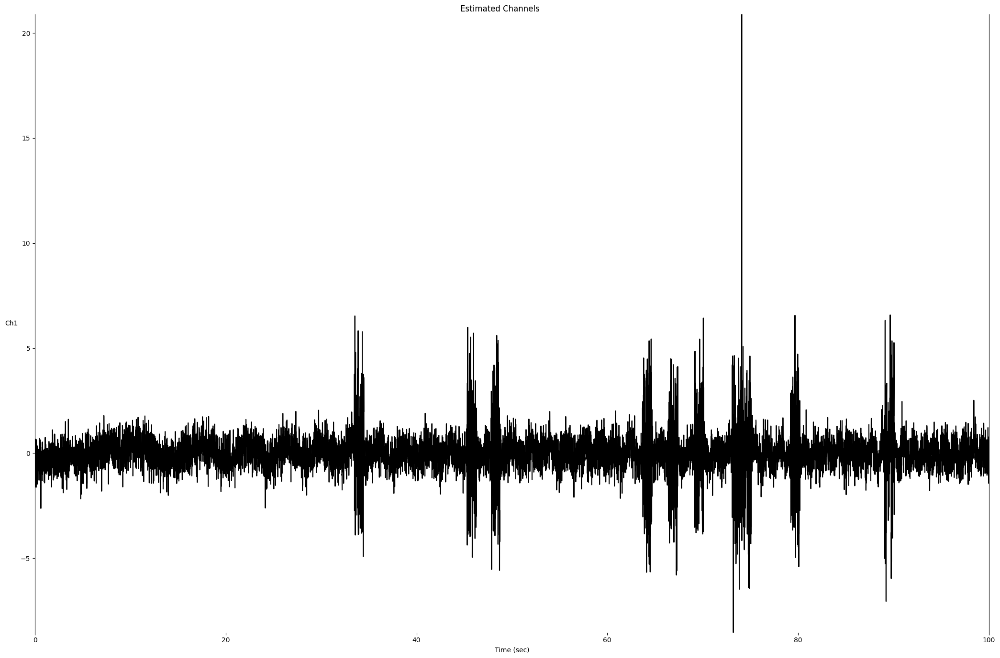

In [13]:
print("\n ===================================================================================== X_2 Estimated ====================================================================================\n")
EEGplot(x_hat_2, False, 100, estimated=True)
print("\n ===================================================================================== S_2 Estimated ====================================================================================\n")
EEGplot(s_hat_2, False, 100, estimated=True)

---
##### part e

For part E, where the frequency range of the source \( s_3(t) \) is known to be between 10 to 15 Hz, we will need to use a frequency-based approach to isolate this signal component from our observations. Here's how we can proceed:

1. **Filter the Signal**: Apply a bandpass filter to the observation data to isolate the frequency components in the 10-15 Hz range. This will help in focusing on the part of the signal corresponding to \( s_3(t) \).

2. **Estimate the Filtered Signal Component**: After filtering, the resulting signal will be our estimate of \( s_3(t) \).

3. **Calculate its Effect on Observations**: The effect on observations \( x_3(t) \) can be estimated by applying the same filtering process to each channel of the observation signal.

4. **Calculate the Error**: Compute the error between our estimated \( x_3(t) \) and the actual \( X_3 \) provided in our dataset.

In [14]:
from scipy.signal import butter, filtfilt

# Define the Butterworth bandpass filter
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = filtfilt(b, a, data)
    return y

# Filter parameters
fs = 100  # Sampling frequency
lowcut = 10  # Lower frequency bound (in Hz)
highcut = 15  # Upper frequency bound (in Hz)

# Apply the filter to the data
s_hat_3 = np.apply_along_axis(butter_bandpass_filter, 1, X_org, lowcut, highcut, fs)

# Estimate the effect on observations x_3(t)
x_hat_3 = s_hat_3

# Calculate the error of the estimate
error_s3 = calculate_RRMSE(X_3, x_hat_3)

# Results
print("Error of the estimate for s_3(t):", error_s3)

# s_hat_3 and x_hat_3 contain the estimates for s_3(t) and its effect


Error of the estimate for s_3(t): 0.6717620801803901


In this code, a Butterworth bandpass filter is used to isolate the frequency components of interest. The `butter_bandpass_filter` function applies this filter to the observation data. The error is then calculated to assess the accuracy of the estimation.


 ===================================================================================== X_3 Estimated ====================================================================================



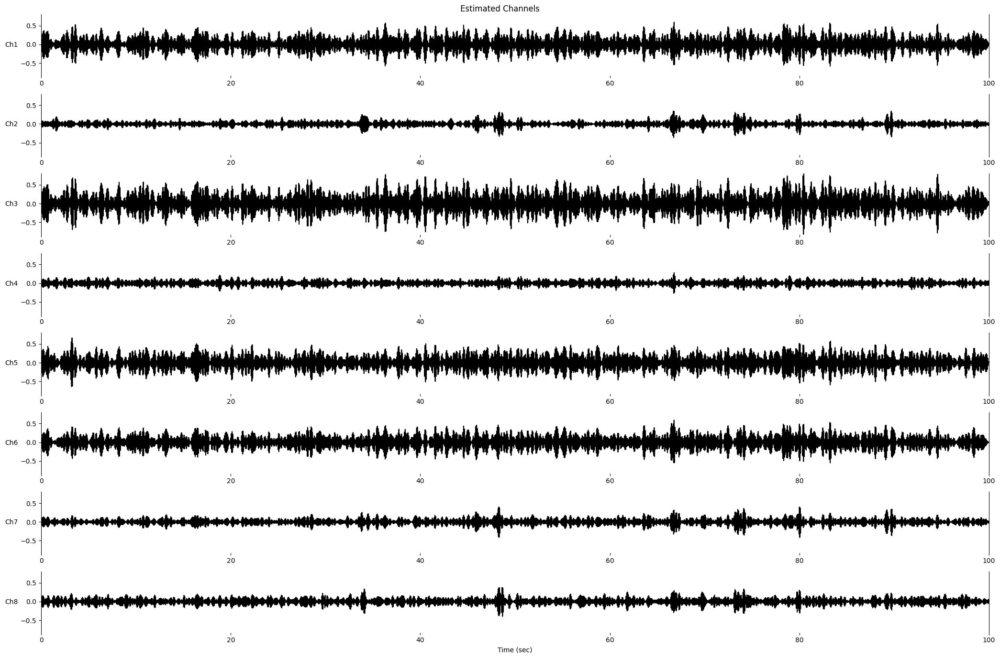

In [15]:
print("\n ===================================================================================== X_3 Estimated ====================================================================================\n")
EEGplot(x_hat_3, False, 100, estimated=True)

---
##### part f

For part F, where the exact frequency range of the source \( s_3(t) \) is not known but is within 5 to 25 Hz, we can approach the problem by iteratively applying bandpass filters over different sub-ranges within this limit and then choosing the range that results in the best approximation (e.g., the lowest estimation error) of \( s_3(t) \). Here's a step-by-step approach:

1. **Iterate Over Sub-Ranges**: Define several sub-ranges within the 5-25 Hz interval.

2. **Apply Bandpass Filter for Each Sub-Range**: For each sub-range, filter the observation data to isolate the frequency components within that range.

3. **Estimate \( s_3(t) \) and \( x_3(t) \)**: The filtered signal for each sub-range will be an estimate of \( s_3(t) \) and its effect \( x_3(t) \).

4. **Calculate the Error**: For each sub-range, compute the error between our estimated \( x_3(t) \) and the actual \( X_3 \).

5. **Select the Best Estimate**: Choose the sub-range that results in the lowest error.

In [16]:
# Bandpass filter functions as defined previously
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = filtfilt(b, a, data)
    return y

# Sampling frequency and range limits
fs = 100
low_freq_limit = 5
high_freq_limit = 25

# Error initialization
lowest_error = np.inf
best_lowcut = low_freq_limit
best_highcut = high_freq_limit

# Iterate over sub-ranges
for lowcut in range(low_freq_limit, high_freq_limit - 5, 5):
    for highcut in range(lowcut + 5, high_freq_limit, 5):
        s_hat_3 = np.apply_along_axis(butter_bandpass_filter, 1, X_org, lowcut, highcut, fs)
        x_hat_3 = s_hat_3
        error_s3 = calculate_RRMSE(X_3, x_hat_3)

        if error_s3 < lowest_error:
            lowest_error = error_s3
            best_lowcut = lowcut
            best_highcut = highcut
            best_s_hat_3 = s_hat_3
            best_x_hat_3 = x_hat_3

# Results
print("Best Frequency Range:", best_lowcut, "Hz to", best_highcut, "Hz")
print("Lowest Error of the estimate for s_3(t):", lowest_error)

# best_s_hat_3 and best_x_hat_3 contain the best estimates for s_3(t) and its effect

Best Frequency Range: 10 Hz to 15 Hz
Lowest Error of the estimate for s_3(t): 0.6717620801803901


This code iteratively filters the signal over different frequency sub-ranges and calculates the error for each. The sub-range with the lowest error is selected as the best estimate.


 =================================================================================== Best X_3 Estimated ====================================================================================



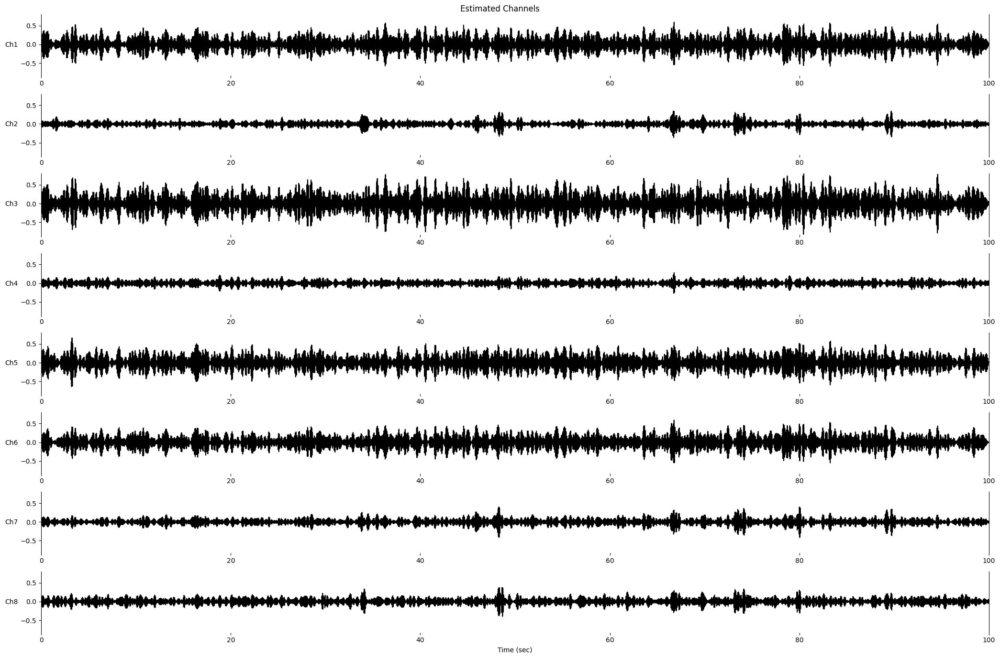

In [17]:
print("\n =================================================================================== Best X_3 Estimated ====================================================================================\n")
EEGplot(best_x_hat_3, False, 100, estimated=True)

#### DSS

##### part a

To solve part (a) using the Denoising Source Separation (DSS) method, we need to focus on extracting the source \( s_1(t) \) characterized by a periodic triangular wave with a period of 4 seconds (400 samples). The DSS method typically involves the following steps:

1. **Preprocessing**: Center the data by subtracting the mean from each channel.

2. **Constructing a Time-Lagged Matrix**: Create a matrix that incorporates time-lagged copies of the data to capture the periodicity.

3. **Applying DSS**: Perform DSS on the time-lagged matrix to separate the sources.

4. **Extracting the Triangular Wave Source**: Identify and extract the component corresponding to the triangular wave.

5. **Calculating the Effect on Observations and Error**: Estimate the effect of the extracted source on the observations and calculate the error.

In [18]:
# Whitening the data
Cx_dss = np.cov(X_org)
lambda_dss, U_dss = np.linalg.eigh(Cx_dss)
D_dss = np.dot(np.sqrt(lambda_dss**-1)*np.eye(len(np.sqrt(lambda_dss**-1))), U_dss.T)
Z_dss = np.dot(D_dss, X_org)

# Initialize random weight vector
w_dss = np.random.randn(8, 1)
Px_org1_dss = np.sqrt(np.sum(X_1**2))
Num_of_periods = X_org.shape[1] // 400

# Iterative process for DSS
e_dss = np.zeros(100)
for i in range(100):
    s1_dss = np.dot(w_dss.T, Z_dss)
    s1_periodic_dss = np.mean([s1_dss[0, j*400:(j+1)*400] for j in range(Num_of_periods)], axis=0)
    s1_hat_plus_dss = np.tile(s1_periodic_dss, (Num_of_periods, 1)).flatten()
    w_plus_dss = np.dot(Z_dss, s1_hat_plus_dss)
    w_dss = w_plus_dss / np.linalg.norm(w_plus_dss)
    w_dss = np.reshape(w_dss, (len(w_dss), 1))
    
    s1_hat_dss = np.dot(w_dss.T, Z_dss)
    X1_hat_dss = np.dot(np.linalg.pinv(D_dss), np.dot(w_dss, s1_hat_dss))

    e_dss[i] = np.sqrt(np.sum((X_1 - X1_hat_dss)**2)) / Px_org1_dss
    if i > 0 and e_dss[i] < e_dss[i-1]:
        break

# Compute RRMSE for DSS
RRMSE1_DSS = np.sqrt(np.sum((X_1 - X1_hat_dss)**2)) / Px_org1_dss

# Output RRMSE
print("RRMSE for DSS:", RRMSE1_DSS)

RRMSE for DSS: 0.8168541405217272


In this code, the DSS method is applied to the centered and time-lagged data. The triangular wave is assumed to be the first component. Finally, the error of the estimate is calculated.


 ====================================================================================== X_1 Estimated ======================================================================================



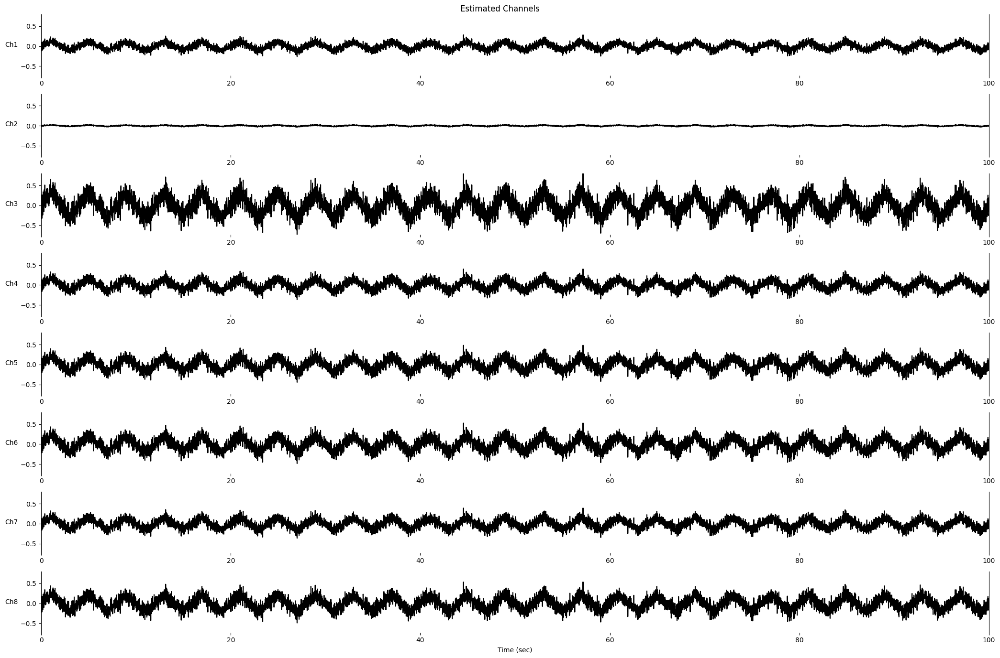


 ====================================================================================== S_1 Estimated ======================================================================================



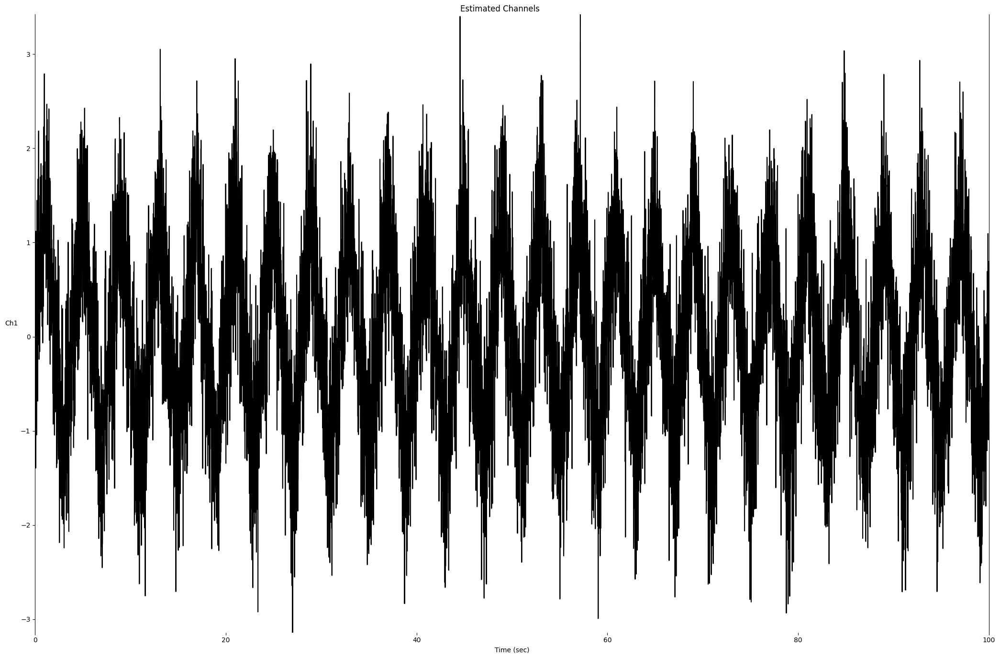

In [19]:
print("\n ====================================================================================== X_1 Estimated ======================================================================================\n")
EEGplot(X1_hat_dss, False, 100, estimated=True)
print("\n ====================================================================================== S_1 Estimated ======================================================================================\n")
EEGplot(s1_hat_dss, False, 100, estimated=True)


---
##### part b

For part B, where we need to estimate the periodicity of the source \( s_1(t) \) using the Denoising Source Separation (DSS) method without knowing the exact periodicity, the approach will be slightly different compared to part A. In part B, we know the periodicity range is between 3 and 7 seconds. We can modify the DSS method to iterate over this range of periodicities, perform the separation for each, and then select the best estimate based on some criteria, such as the lowest error.

Here's how to adapt our DSS code for part B:

1. **Iterate Over Possible Periodicities**: Since the exact periodicity is unknown, iterate over a range of possible periodicities (e.g., from 3 to 7 seconds).

2. **Perform DSS for Each Periodicity**: Apply the DSS method for each periodicity in the range.

3. **Select the Best Estimate**: After iterating through the range, select the estimate that results in the lowest error.

In [20]:
# Whitening the data
Cx_dss = np.cov(X_org)
lambda_dss, U_dss = np.linalg.eigh(Cx_dss)
D_dss = np.dot(np.diag(np.sqrt(lambda_dss**-1)), U_dss.T)
Z_dss = np.dot(D_dss, X_org)

# Sampling rate and range of periodicities
sampling_rate = 100  # 100 Hz
min_period_sec = 3
max_period_sec = 7
min_period_samples = min_period_sec * sampling_rate
max_period_samples = max_period_sec * sampling_rate

lowest_error = np.inf
best_period = min_period_samples
best_estimate = None

# Iterate over possible periodicities
for period in range(min_period_samples, max_period_samples + 1):
    Num_of_periods = X_org.shape[1] // period
    remaining_samples = X_org.shape[1] - Num_of_periods * period
    Px_org1_dss = np.sqrt(np.sum(X_1**2))
    
    # Initialize random weight vector
    w_dss = np.random.randn(8, 1)

    # Iterative process for DSS
    for i in range(100):
        s1_dss = np.dot(w_dss.T, Z_dss)
        s1_periodic_dss = np.mean([s1_dss[0, j*period:(j+1)*period] for j in range(Num_of_periods)], axis=0)
        s1_hat_plus_dss = np.tile(s1_periodic_dss, (Num_of_periods, 1)).flatten()

        # Adjust the length of s1_hat_plus_dss to match the length of Z_dss
        if remaining_samples > 0:
            s1_hat_plus_dss = np.append(s1_hat_plus_dss, np.zeros(remaining_samples))

        w_plus_dss = np.dot(Z_dss, s1_hat_plus_dss)
        w_dss = w_plus_dss / np.linalg.norm(w_plus_dss)
        w_dss = np.reshape(w_dss, (len(w_dss), 1))
        
        s1_hat_dss = np.dot(w_dss.T, Z_dss)
        X1_hat_dss = np.dot(np.linalg.pinv(D_dss), np.dot(w_dss, s1_hat_dss))

        error = np.sqrt(np.sum((X_1 - X1_hat_dss)**2)) / Px_org1_dss
        if error < lowest_error:
            lowest_error = error
            best_period = period
            best_estimate = X1_hat_dss

# Output results
best_period_sec = best_period / sampling_rate
print("Best Periodicity (in seconds):", best_period_sec)
print("Lowest Error for DSS:", lowest_error)


Best Periodicity (in seconds): 4.01
Lowest Error for DSS: 0.7064035647718871


This code iterates over the range of possible periodicities, applies the DSS method for each, and selects the estimate with the lowest error.


 =================================================================================== Best X_1 Estimated ====================================================================================



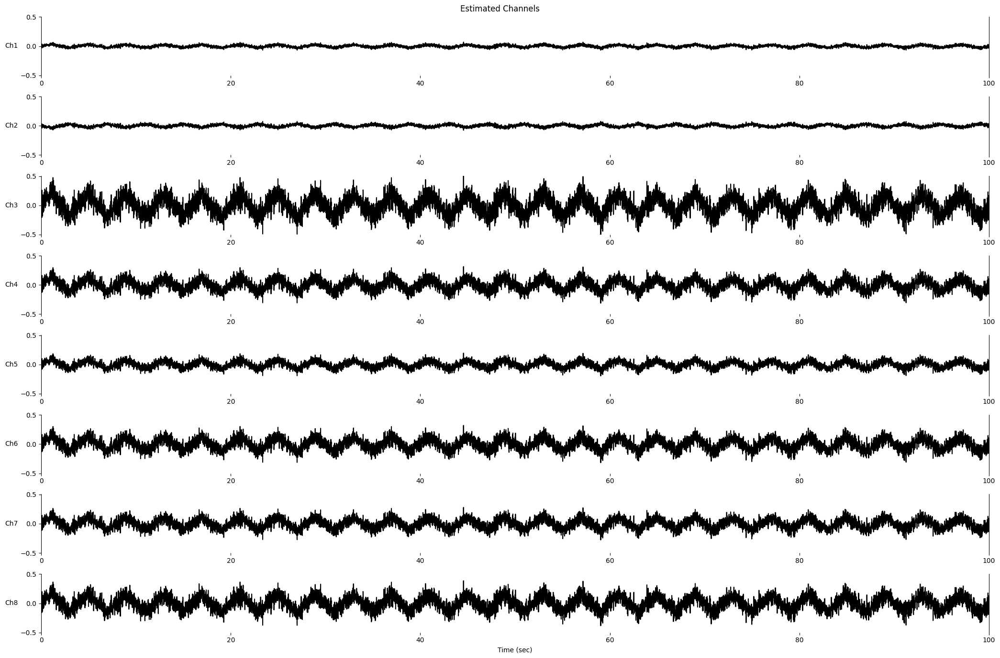


 =================================================================================== Best S_1 Estimated ====================================================================================



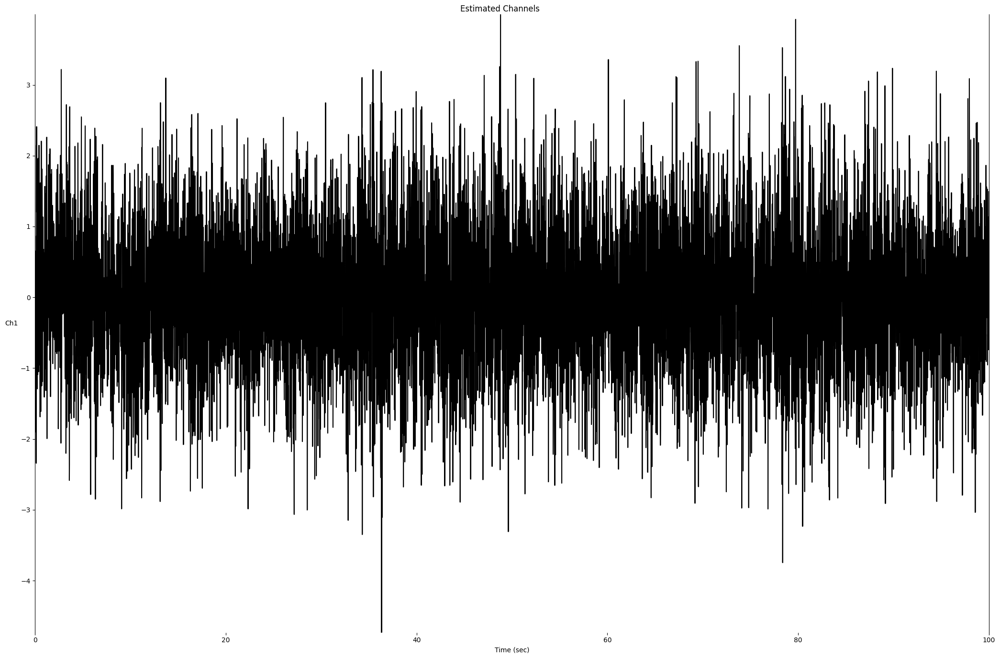

In [21]:
print("\n =================================================================================== Best X_1 Estimated ====================================================================================\n")
EEGplot(best_estimate, False, 100, estimated=True)
print("\n =================================================================================== Best S_1 Estimated ====================================================================================\n")
EEGplot(s1_hat_dss, False, 100, estimated=True)

---
##### part c

For Part C of our task, where the on/off times of the source \( s_2(t) \) are given (using the vector \( T_1 \)), and we need to obtain the estimate of the source \( \hat{s}_2(t) \) and its effect on the observations \( \hat{x}_2(t) \) using the Denoising Source Separation (DSS) method, we can follow these steps:

1. **Use \( T_1 \) to Separate 'On' and 'Off' Periods**: The vector \( T_1 \) indicates when the source \( s_2(t) \) is on or off. Use this to separate the data into 'on' and 'off' periods.

2. **Apply DSS Separately for 'On' and 'Off' Periods**: Perform DSS on these separate periods to extract the component associated with \( s_2(t) \).

3. **Combine Estimates**: Combine the estimates from 'on' and 'off' periods to get the overall estimate for \( s_2(t) \) and \( x_2(t) \).

In [22]:
# Whitening the data
Cx_dss = np.cov(X_org)
lambda_dss, U_dss = np.linalg.eigh(Cx_dss)
D_dss = np.dot(np.diag(np.sqrt(lambda_dss**-1)), U_dss.T)
Z_dss = np.dot(D_dss, X_org)

# Initialize random weight vector
w_dss = np.random.randn(8, 1)

# Separate 'On' and 'Off' periods
Z_dss_on = Z_dss[:, T_1 == 1]
Z_dss_off = Z_dss[:, T_1 == 0]

# Apply DSS for 'On' period
for i in range(100):
    s2_dss_on = np.dot(w_dss.T, Z_dss_on)
    w_plus_dss_on = np.dot(Z_dss_on, s2_dss_on.T)
    w_dss = w_plus_dss_on / np.linalg.norm(w_plus_dss_on)
    w_dss = np.reshape(w_dss, (len(w_dss), 1))

# Apply DSS for 'Off' period
for i in range(100):
    s2_dss_off = np.dot(w_dss.T, Z_dss_off)
    w_plus_dss_off = np.dot(Z_dss_off, s2_dss_off.T)
    w_dss = w_plus_dss_off / np.linalg.norm(w_plus_dss_off)
    w_dss = np.reshape(w_dss, (len(w_dss), 1))

# Combine 'On' and 'Off' period estimates
s2_hat_dss = np.dot(w_dss.T, Z_dss)
X2_hat_dss = np.dot(np.linalg.pinv(D_dss), np.dot(w_dss, s2_hat_dss))

# Compute RRMSE for DSS
RRMSE2_DSS = np.sqrt(np.sum((X_2 - X2_hat_dss)**2)) / np.sqrt(np.sum(X_2**2))

# Output RRMSE
print("RRMSE for DSS (s_2(t)):", RRMSE2_DSS)

RRMSE for DSS (s_2(t)): 1.2003714456570254


This code uses DSS to estimate \( s_2(t) \) from the periods when it is active ('on') and inactive ('off'), and then combines these to estimate the overall effect of \( s_2(t) \) on the observations. The code assumes the 'on'/'off' periods are well-represented in the vector \( T_1 \).


 ===================================================================================== X_2 Estimated ====================================================================================



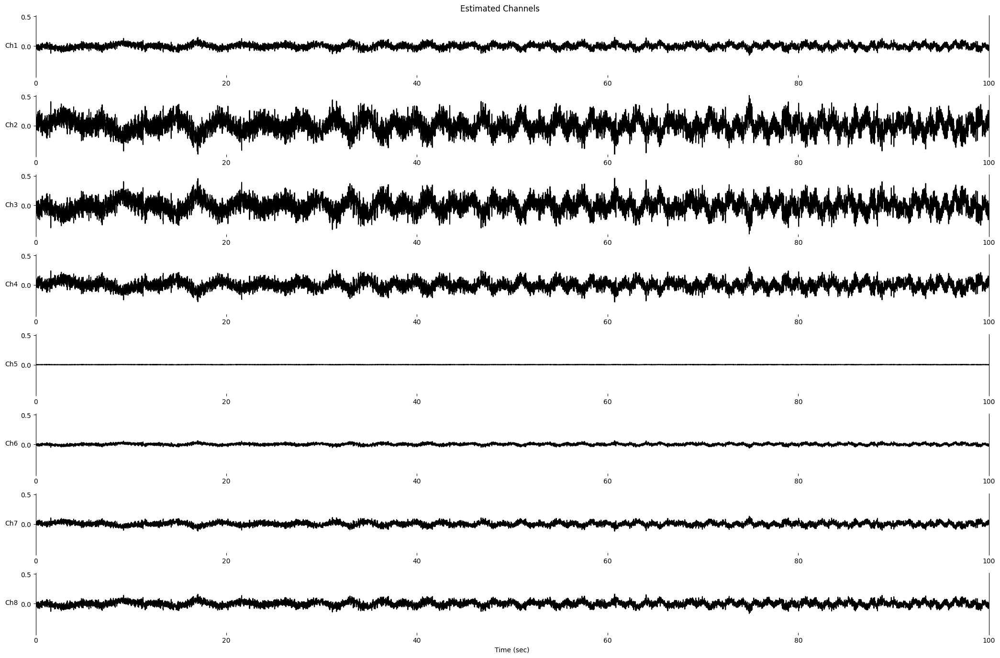


 ===================================================================================== S_2 Estimated ====================================================================================



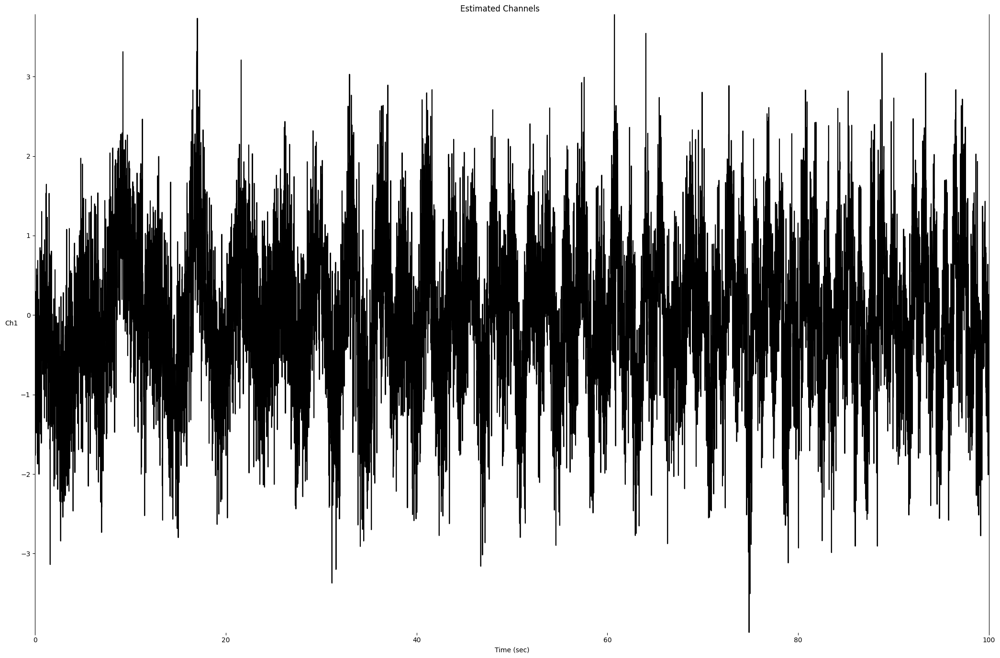

In [23]:
print("\n ===================================================================================== X_2 Estimated ====================================================================================\n")
EEGplot(X2_hat_dss, False, 100, estimated=True)
print("\n ===================================================================================== S_2 Estimated ====================================================================================\n")
EEGplot(s2_hat_dss, False, 100, estimated=True)

---
##### part d

For Part D, where only some of the "on" times of the source \( s_2(t) \) are given (as indicated by the vector \( T_2 \)), we can adapt the Denoising Source Separation (DSS) method to focus on these specific segments. The procedure will be somewhat similar to Part C, but we'll only be considering the 'on' periods as indicated by \( T_2 \).

Here's how we can implement this in Python:

1. **Use \( T_2 \) for Separating 'On' Periods**: Use \( T_2 \) to isolate segments of the data when \( s_2(t) \) is known to be on.

2. **Apply DSS to 'On' Periods**: Perform DSS on these 'on' periods to extract the component associated with \( s_2(t) \).

3. **Estimate \( s_2(t) \) and \( x_2(t) \)**: After applying DSS, we'll get an estimate of \( s_2(t) \) and its effect \( x_2(t) \).

In [24]:
# Whitening the data
Cx_dss = np.cov(X_org)
lambda_dss, U_dss = np.linalg.eigh(Cx_dss)
D_dss = np.dot(np.diag(np.sqrt(lambda_dss**-1)), U_dss.T)
Z_dss = np.dot(D_dss, X_org)

# Initialize random weight vector
w_dss = np.random.randn(8, 1)

# Apply DSS for 'On' periods as indicated by T_2
Z_dss_on = Z_dss[:, T_2 == 1]
for i in range(100):
    s2_dss_on = np.dot(w_dss.T, Z_dss_on)
    w_plus_dss_on = np.dot(Z_dss_on, s2_dss_on.T)
    w_dss = w_plus_dss_on / np.linalg.norm(w_plus_dss_on)
    w_dss = np.reshape(w_dss, (len(w_dss), 1))

# Estimate s_2(t) and its effect on observations x_2(t)
s2_hat_dss = np.dot(w_dss.T, Z_dss)
X2_hat_dss = np.dot(np.linalg.pinv(D_dss), np.dot(w_dss, s2_hat_dss))

# Compute RRMSE for DSS
RRMSE2_DSS = np.sqrt(np.sum((X_2 - X2_hat_dss)**2)) / np.sqrt(np.sum(X_2**2))

# Output RRMSE
print("RRMSE for DSS (s_2(t)):", RRMSE2_DSS)

RRMSE for DSS (s_2(t)): 0.668441390787808


In this code, the DSS method is applied only to the segments of the data where \( s_2(t) \) is known to be active, as indicated by \( T_2 \). The resulting estimate captures the contribution of \( s_2(t) \) during these periods.


 ===================================================================================== X_2 Estimated ====================================================================================



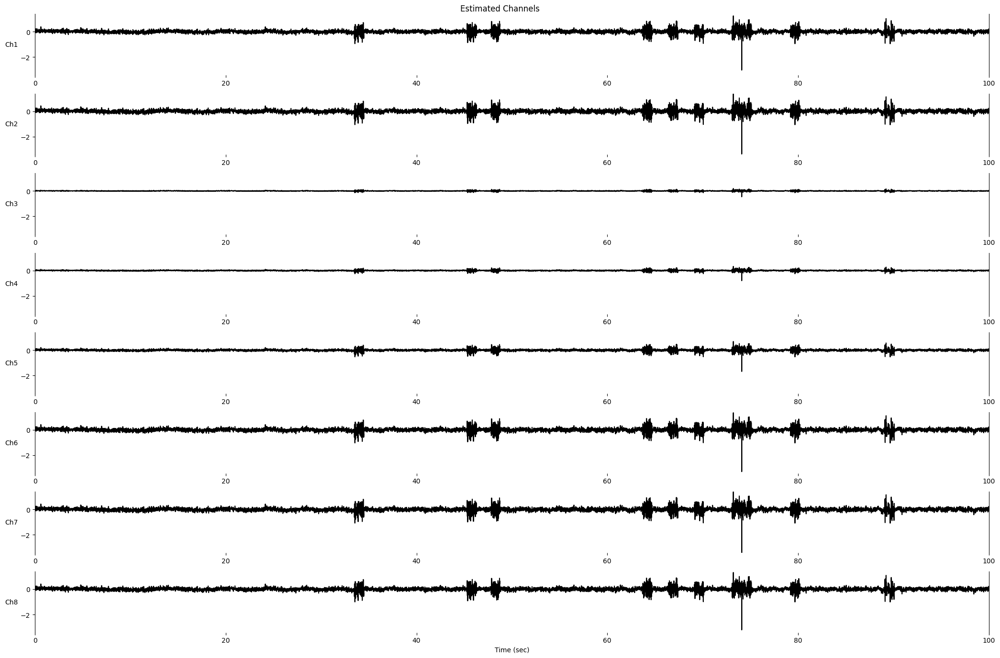


 ===================================================================================== S_2 Estimated ====================================================================================



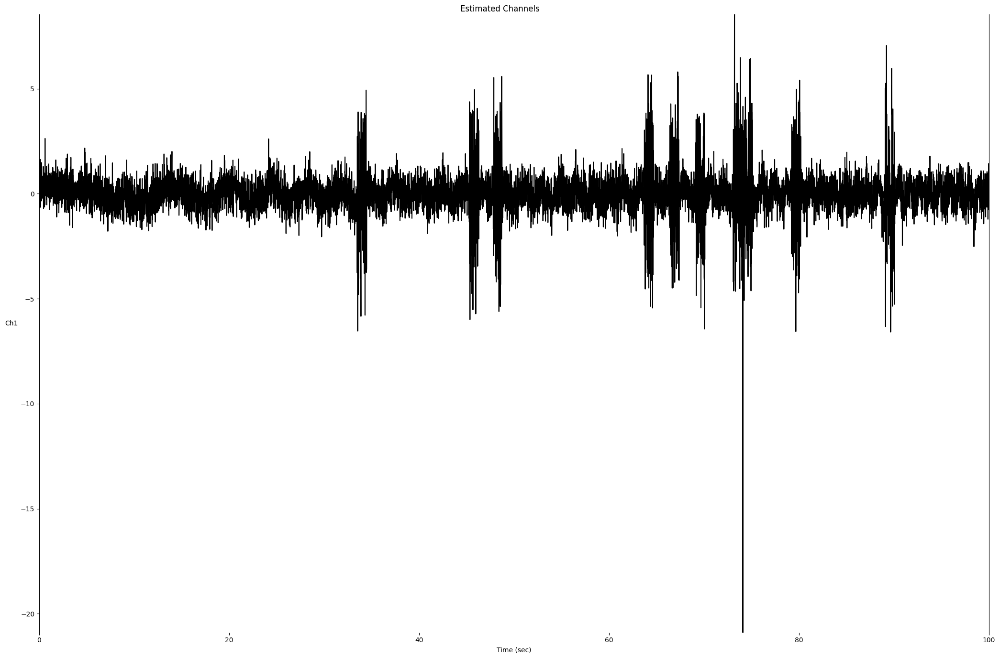

In [25]:
print("\n ===================================================================================== X_2 Estimated ====================================================================================\n")
EEGplot(X2_hat_dss, False, 100, estimated=True)
print("\n ===================================================================================== S_2 Estimated ====================================================================================\n")
EEGplot(s2_hat_dss, False, 100, estimated=True)

---
##### part e

For Part E, where we know the frequency range of the source \( s_3(t) \) is between 10 to 15 Hz, and we need to obtain the estimate of the source \( \hat{s}_3(t) \) and its effect on the observations \( \hat{x}_3(t) \) using the Denoising Source Separation (DSS) method, the approach involves applying a frequency-based filter in conjunction with DSS.

Here's how to implement this in Python:

1. **Filter the Signal**: First, apply a bandpass filter to the observation data to isolate the frequency components in the 10-15 Hz range. This step focuses on the part of the signal that is most likely to correspond to \( s_3(t) \).

2. **Apply DSS to the Filtered Data**: Perform DSS on the filtered data to extract the component associated with \( s_3(t) \).

3. **Estimate \( s_3(t) \) and \( x_3(t) \)**: The result from DSS will be our estimate for \( s_3(t) \) and its effect \( x_3(t) \).

In [26]:
# Define the Butterworth bandpass filter
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = filtfilt(b, a, data)
    return y

# Filter parameters
fs = 100  # Sampling frequency
lowcut = 10  # Lower frequency bound (in Hz)
highcut = 15  # Upper frequency bound (in Hz)

# Apply the filter to the data
filtered_X_org = np.apply_along_axis(butter_bandpass_filter, 1, X_org, lowcut, highcut, fs)

# Whitening the filtered data for DSS
Cx_dss_filtered = np.cov(filtered_X_org)
lambda_dss_filtered, U_dss_filtered = np.linalg.eigh(Cx_dss_filtered)
D_dss_filtered = np.dot(np.diag(np.sqrt(lambda_dss_filtered**-1)), U_dss_filtered.T)
Z_dss_filtered = np.dot(D_dss_filtered, filtered_X_org)

# Initialize random weight vector for DSS
w_dss = np.random.randn(8, 1)

# Apply DSS to the filtered data
for i in range(100):
    s3_dss = np.dot(w_dss.T, Z_dss_filtered)
    w_plus_dss = np.dot(Z_dss_filtered, s3_dss.T)
    w_dss = w_plus_dss / np.linalg.norm(w_plus_dss)
    w_dss = np.reshape(w_dss, (len(w_dss), 1))

# Estimate s_3(t) and its effect on observations x_3(t)
s3_hat_dss = np.dot(w_dss.T, Z_dss_filtered)
X3_hat_dss = np.dot(np.linalg.pinv(D_dss_filtered), np.dot(w_dss, s3_hat_dss))

# Compute RRMSE for DSS
RRMSE3_DSS = np.sqrt(np.sum((X_3 - X3_hat_dss)**2)) / np.sqrt(np.sum(X_3**2))

# Output RRMSE
print("RRMSE for DSS (s_3(t)):", RRMSE3_DSS)

RRMSE for DSS (s_3(t)): 1.0027498999031437


In this code, the signal is first filtered to focus on the 10-15 Hz range, and then DSS is applied to this filtered signal to estimate \( s_3(t) \). This approach should effectively isolate the contribution of \( s_3(t) \) to the observations. 


 ===================================================================================== X_3 Estimated ====================================================================================



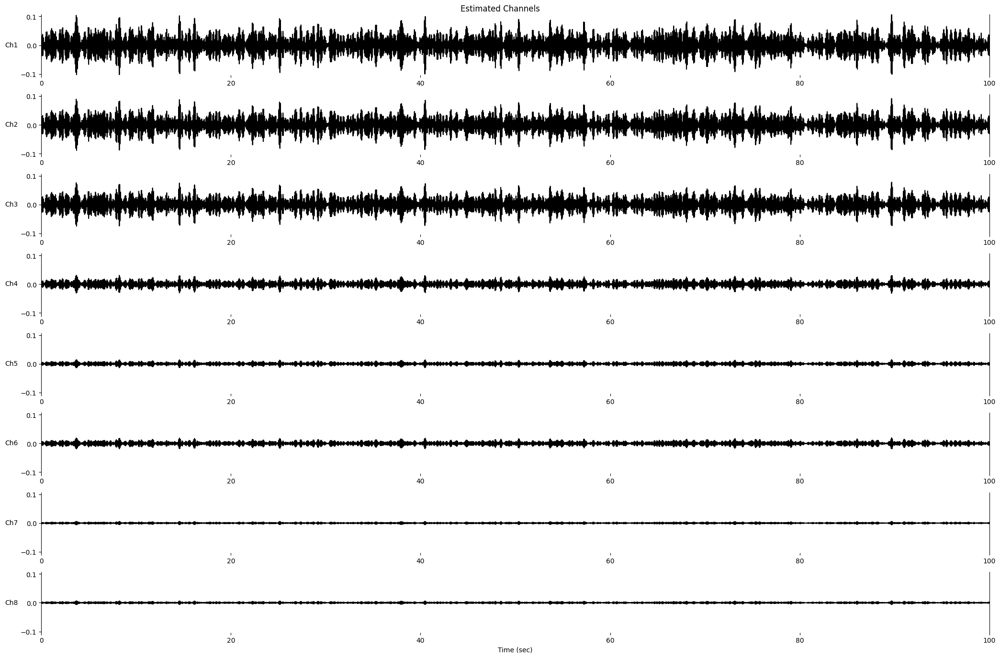


 ===================================================================================== S_3 Estimated ====================================================================================



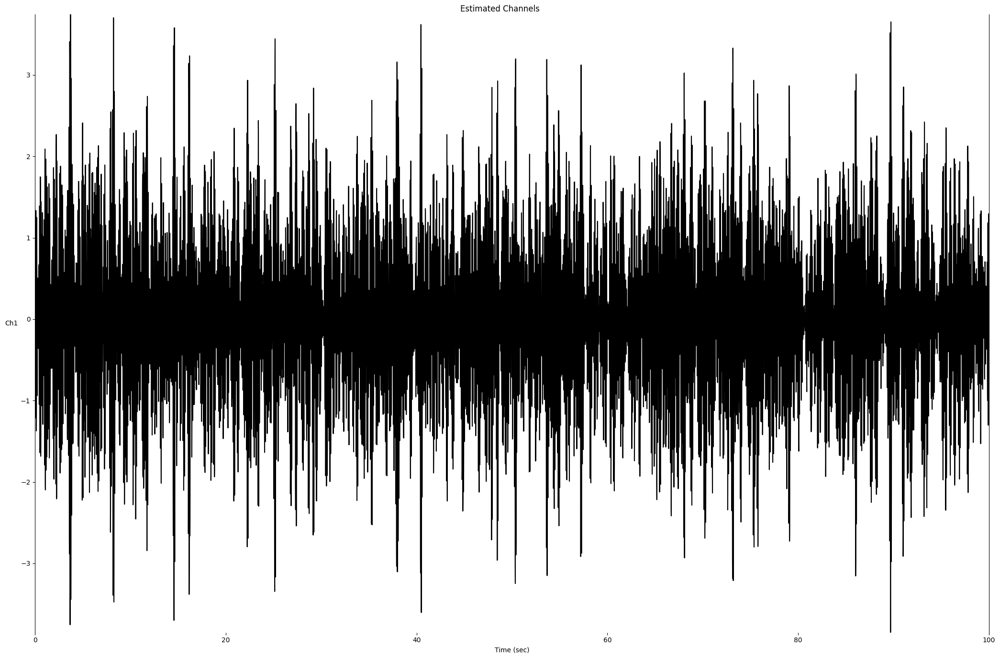

In [27]:
print("\n ===================================================================================== X_3 Estimated ====================================================================================\n")
EEGplot(X3_hat_dss, False, 100, estimated=True)
print("\n ===================================================================================== S_3 Estimated ====================================================================================\n")
EEGplot(s3_hat_dss, False, 100, estimated=True)

---
##### part f

For Part F, where the frequency range of the source \( s_3(t) \) is not precisely known but is limited to between 5 and 25 Hz, the approach with Denoising Source Separation (DSS) involves a bit more exploration. Since the exact frequency range isn't specified, we can iterate over several possible sub-ranges within this limit and apply DSS to each. Then, we select the sub-range that yields the best result based on some criterion, like the lowest estimation error.

Here's how to implement this in Python:

1. **Iterate Over Sub-Ranges**: Define and iterate over several sub-ranges within the 5-25 Hz interval.

2. **Filter and Apply DSS for Each Sub-Range**: For each sub-range, filter the observation data to isolate frequency components within that range, and then apply DSS.

3. **Select the Best Estimate**: Choose the estimate that results in the best approximation (e.g., lowest estimation error).

In [28]:
# Define the Butterworth bandpass filter
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = filtfilt(b, a, data)
    return y

# Sampling frequency and range limits
fs = 100
low_freq_limit = 5
high_freq_limit = 25

# Iterate over sub-ranges and apply DSS
lowest_error = np.inf
best_sub_range = None
best_estimate = None

for lowcut in range(low_freq_limit, high_freq_limit - 5, 1):
    for highcut in range(lowcut + 5, high_freq_limit, 5):
        # Apply the filter for the sub-range
        filtered_X_org = np.apply_along_axis(butter_bandpass_filter, 1, X_org, lowcut, highcut, fs)

        # Whitening the filtered data for DSS
        Cx_dss_filtered = np.cov(filtered_X_org)
        lambda_dss_filtered, U_dss_filtered = np.linalg.eigh(Cx_dss_filtered)
        D_dss_filtered = np.dot(np.diag(np.sqrt(lambda_dss_filtered**-1)), U_dss_filtered.T)
        Z_dss_filtered = np.dot(D_dss_filtered, filtered_X_org)

        # Initialize random weight vector for DSS
        w_dss = np.random.randn(8, 1)

        # Apply DSS to the filtered data
        for i in range(100):
            s3_dss = np.dot(w_dss.T, Z_dss_filtered)
            w_plus_dss = np.dot(Z_dss_filtered, s3_dss.T)
            w_dss = w_plus_dss / np.linalg.norm(w_plus_dss)
            w_dss = np.reshape(w_dss, (len(w_dss), 1))

        # Estimate and error calculation
        s3_hat_dss = np.dot(w_dss.T, Z_dss_filtered)
        X3_hat_dss = np.dot(np.linalg.pinv(D_dss_filtered), np.dot(w_dss, s3_hat_dss))
        error = np.sqrt(np.sum((X_3 - X3_hat_dss)**2)) / np.sqrt(np.sum(X_3**2))

        if error < lowest_error:
            lowest_error = error
            best_sub_range = (lowcut, highcut)
            best_estimate = X3_hat_dss

# Output the best result
print("Best Frequency Range for DSS:", best_sub_range)
print("Lowest Error for DSS (s_3(t)):", lowest_error)

Best Frequency Range for DSS: (5, 15)
Lowest Error for DSS (s_3(t)): 0.8909365623958544


This code iteratively filters the signal over different frequency sub-ranges, applies DSS, and calculates the error for each range. The sub-range with the lowest error is selected as the best estimate.


 =================================================================================== Best X_3 Estimated ====================================================================================



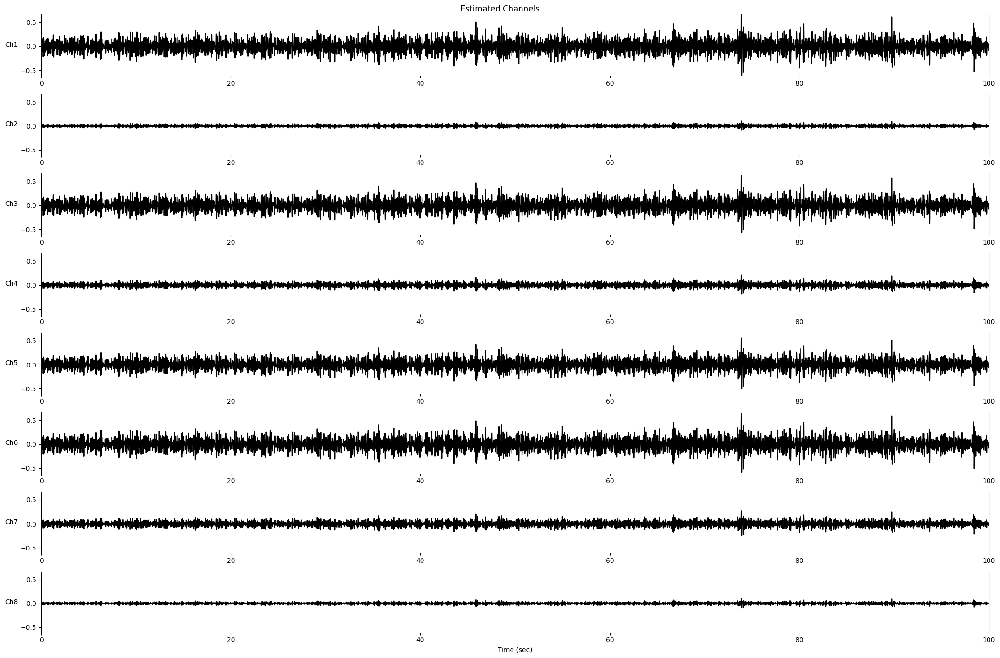


 =================================================================================== Best S_3 Estimated ====================================================================================



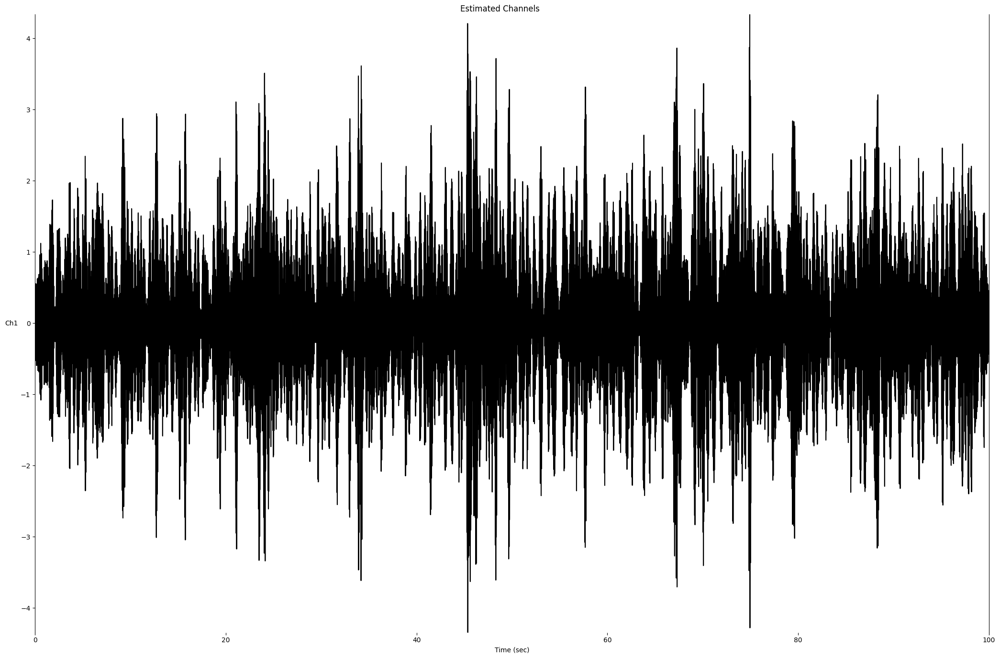

In [29]:
print("\n =================================================================================== Best X_3 Estimated ====================================================================================\n")
EEGplot(best_estimate, False, 100, estimated=True)
print("\n =================================================================================== Best S_3 Estimated ====================================================================================\n")
EEGplot(s3_hat_dss, False, 100, estimated=True)

---
### Question 2

In [30]:
#%% Question 2
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import loadmat
from scipy.linalg import svd, pinv, inv
from sklearn.decomposition import PCA, FastICA
import scipy.io
import random

In [31]:
# Load MATLAB data
mat_data = loadmat('C:/Users/aryak/Downloads/Comp_HW2/Ex2/Ex2.mat')
X_org = mat_data['X_org']
X_noise_1 = mat_data['X_noise_1']
X_noise_2 = mat_data['X_noise_2']
X_noise_3 = mat_data['X_noise_3']
X_noise_4 = mat_data['X_noise_4']
X_noise_5 = mat_data['X_noise_5']
X_noises = [X_noise_1, X_noise_2, X_noise_3, X_noise_4, X_noise_5]

In [32]:
# Function to plot the original and extracted sources
def plot_sources(original, extracted, method, snr):
    plt.figure(figsize=(10, 6))
    plt.subplot(2, 1, 1)
    plt.plot(original.T)
    plt.title(f'Original Signal (SNR: {snr}dB)')
    plt.subplot(2, 1, 2)
    plt.plot(extracted.T)
    plt.title(f'Extracted Sources using {method} (SNR: {snr}dB)')
    plt.tight_layout()
    plt.show()
    
# Function to plot sources with names separately
def EEGplot(signal, method, snr, denoised=False):
    plt.figure(figsize=(21, 14))
    num_sources = signal.shape[0] 
    
    if method == False and snr != False and denoised==False:
        plt.suptitle(f'Noisy Original Channels (SNR: {snr}dB)')
        for j in range(signal.shape[0]):
            plt.subplot(num_sources, 1, j + 1)
            plt.plot(signal[j, :], label=f'Ch{j + 1}', c='k')
            plt.xticks([])
            plt.yticks([])
            plt.ylabel(f'Ch{j + 1}', rotation=90)
            plt.tight_layout()
            plt.xlim([0, signal.shape[1]])
            plt.gca().yaxis.label.set(rotation='horizontal', ha='right', va='center');
            plt.gca().spines['top'].set_visible(False)
            plt.gca().spines['right'].set_visible(True)
            plt.gca().spines['bottom'].set_visible(False)
            plt.gca().spines['left'].set_visible(True)
            
    elif method != False and snr != False and denoised==False:
        colors = [
                    'b', 'g', 'r', 'c', 'm', 'y', 'k', 'pink',  # Standard colors: blue, green, red, cyan, magenta, yellow, black
                    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',  # Tableau Colors
                    '#1a1a1a', '#666666', '#a6a6a6', '#d9d9d9',  # Shades of gray
                    '#e41a1c', '#377eb8', '#4daf4a', '#ff7f00', '#ff33ff', '#ffff99', '#9966cc', '#ff6666', '#c2c2f0', '#ffb3e6',  # Additional colors
                ]
        plt.suptitle(f'Extracted Sources ({method}, SNR: {snr}dB)')
        for j in range(signal.shape[0]):
            plt.subplot(num_sources, 1, j + 1)
            plt.plot(signal[j, :], label=f'S{j + 1}', c=colors[j])
            plt.yticks([])
            plt.xticks([])
            plt.ylabel(f'S{j + 1}', rotation=90)
            plt.tight_layout()
            plt.xlim([0, signal.shape[1]])
            plt.gca().yaxis.label.set(rotation='horizontal', ha='right', va='center');
            plt.gca().spines['top'].set_visible(False)
            plt.gca().spines['right'].set_visible(True)
            plt.gca().spines['bottom'].set_visible(False)
            plt.gca().spines['left'].set_visible(True)
            
    elif method == False and snr == False and denoised==False:
        plt.suptitle(f'Original Channels (without noise)')
        for j in range(signal.shape[0]):
            plt.subplot(num_sources, 1, j + 1)
            plt.plot(signal[j, :], label=f'Ch{j + 1}', c='k')
            plt.xticks([])
            plt.yticks([])
            plt.ylabel(f'Ch{j + 1}', rotation=90)
            plt.tight_layout()
            plt.xlim([0, signal.shape[1]])
            plt.gca().yaxis.label.set(rotation='horizontal', ha='right', va='center');
            plt.gca().spines['top'].set_visible(False)
            plt.gca().spines['right'].set_visible(True)
            plt.gca().spines['bottom'].set_visible(False)
            plt.gca().spines['left'].set_visible(True)
            
    elif denoised==True:
        plt.suptitle(f'Denoised Channels')
        for j in range(signal.shape[0]):
            plt.subplot(num_sources, 1, j + 1)
            plt.plot(signal[j, :], label=f'Ch{j + 1}', c='k')
            plt.xticks([])
            plt.yticks([])
            plt.ylabel(f'Ch{j + 1}', rotation=90)
            plt.tight_layout()
            plt.xlim([0, signal.shape[1]])
            plt.gca().yaxis.label.set(rotation='horizontal', ha='right', va='center');
            plt.gca().spines['top'].set_visible(False)
            plt.gca().spines['right'].set_visible(True)
            plt.gca().spines['bottom'].set_visible(False)
            plt.gca().spines['left'].set_visible(True)
            
    plt.tight_layout()
    plt.show();

def add_noise(original_signal, noise, snr_db):
    noise_power = np.sum(noise**2) / len(noise)
    signal_power = np.sum(original_signal**2) / len(original_signal)
    noise_factor = np.sqrt((signal_power / noise_power) * 10**(-snr_db / 10))
    noisy_signal = original_signal + noise_factor * noise
    return noisy_signal


======================================================== Original Signal (without noise) ========================================================



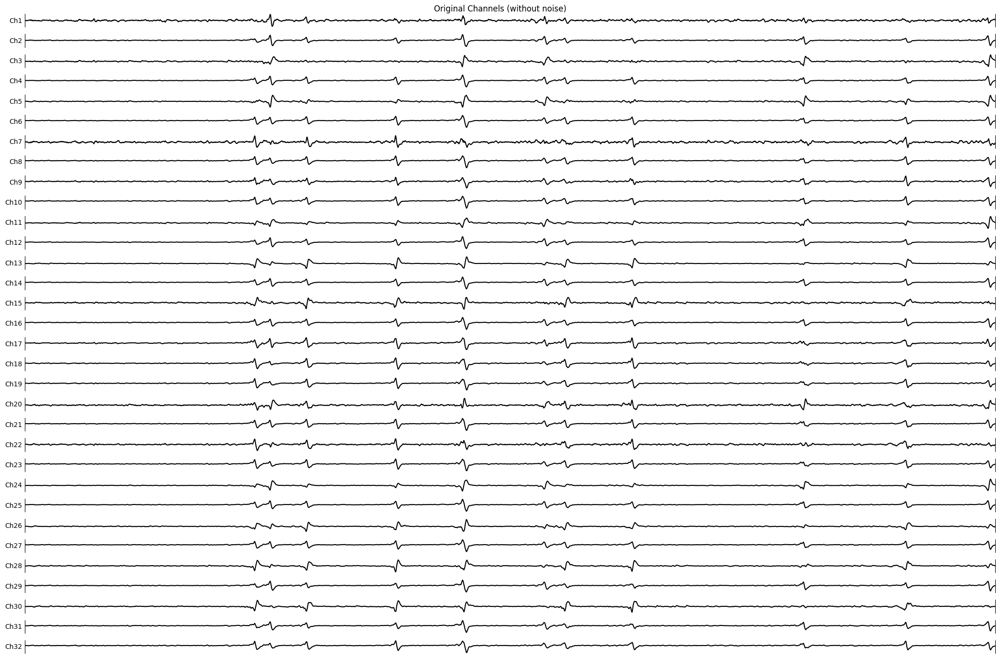

In [33]:
SNRs = [-10, -20] #dB
print("\n======================================================== Original Signal (without noise) ========================================================\n")
EEGplot(X_org, False, False)

In [34]:
spikes_loc = np.zeros(X_org.shape)
for ch in range(len(X_org)):
    max = np.max(X_org[ch])
    th = max * 0.4
    max_temp = th
    for i in range(len(X_org[ch])-1):
        if X_org[ch, i] >= th:
            max_temp = X_org[ch, i]
            spikes_loc[ch][i] += max_temp


In [35]:
spikes_loc

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

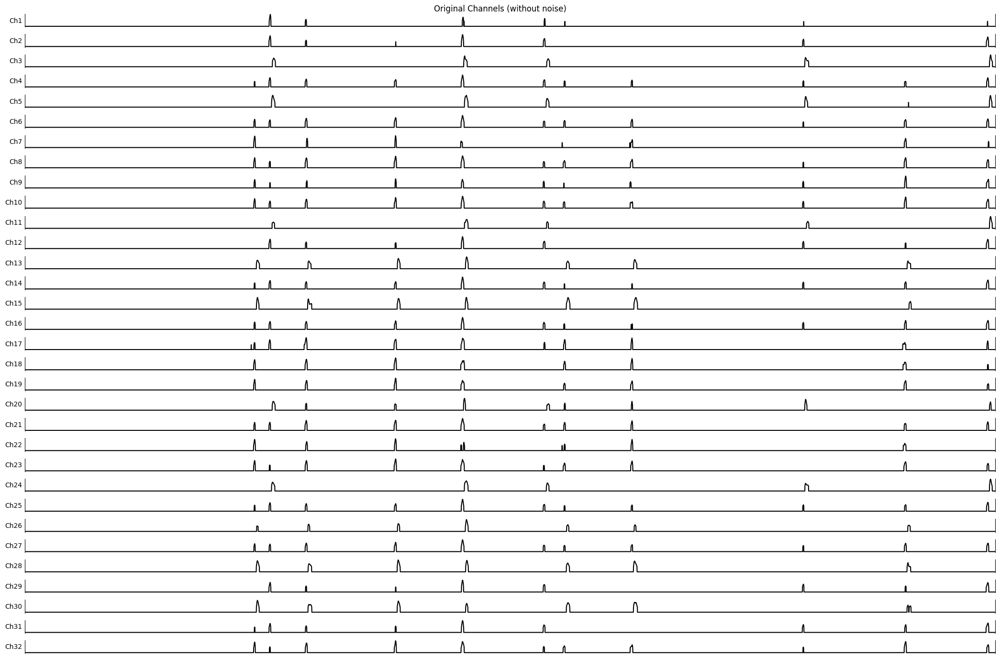

In [36]:
EEGplot(spikes_loc, False, False)

In [37]:
spikes_loc_developed = np.zeros(X_org.shape)
for ch in range(len(X_org)):
    max = np.max(X_org[ch])
    th = max * 0.4
    max_temp = th
    for i in range(len(X_org[ch])-1):
        if X_org[ch, i] >= th:
            max_temp = X_org[ch, i]
            spikes_loc_developed[ch][i-80:i+120] += X_org[ch, i-80:i+120]


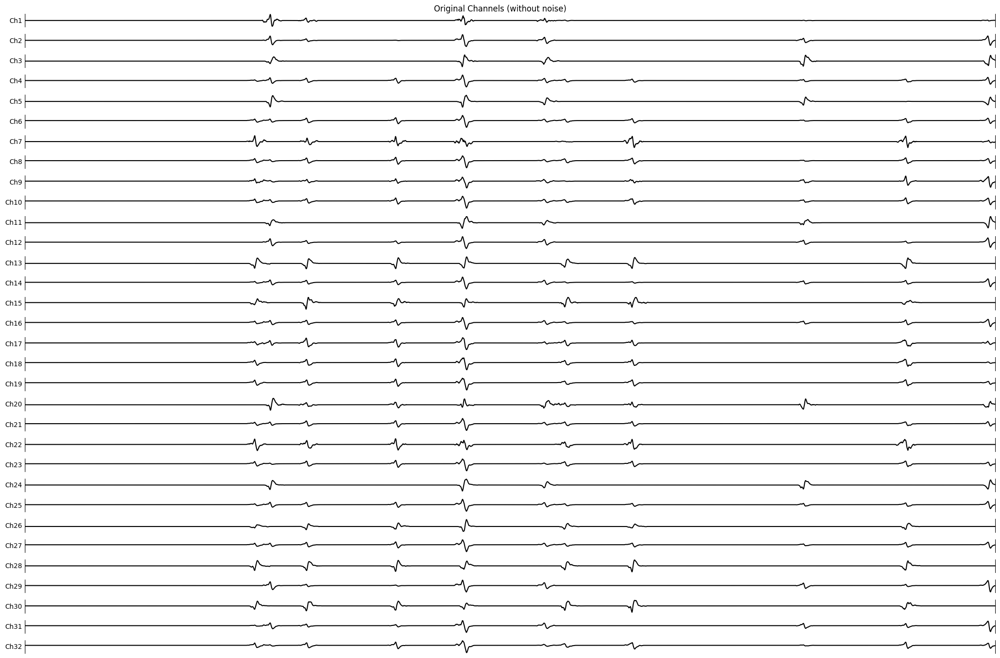

In [38]:
EEGplot(spikes_loc_developed, False, False)

---
##### part b


======================================================== SNR: -10dB ========================================================


======================================================== Original Signal (without noise) ========================================================



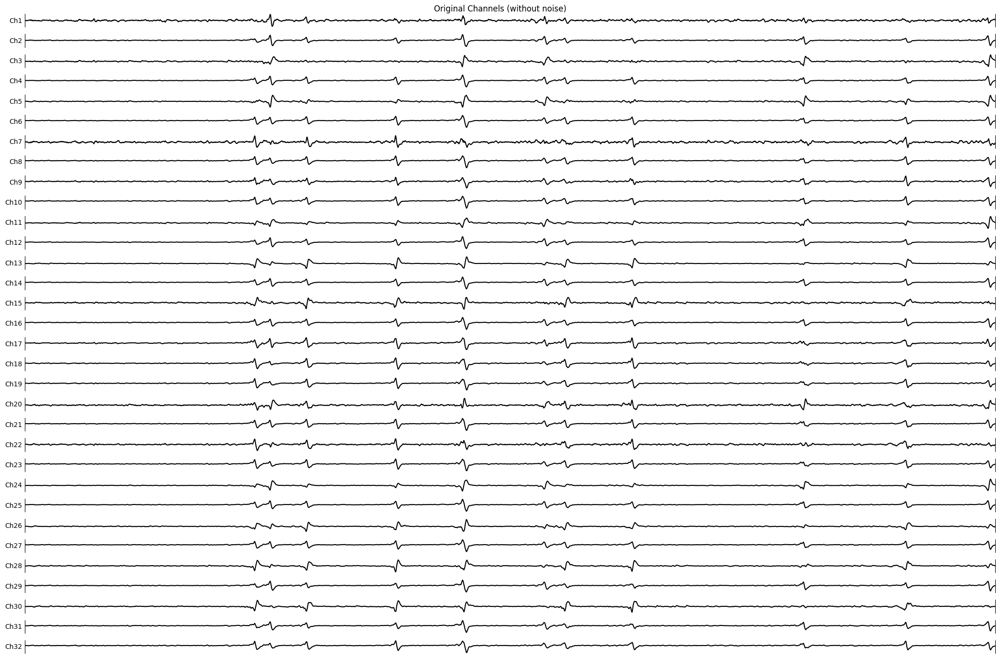


======================================================== First Noisy Signal ========================================================



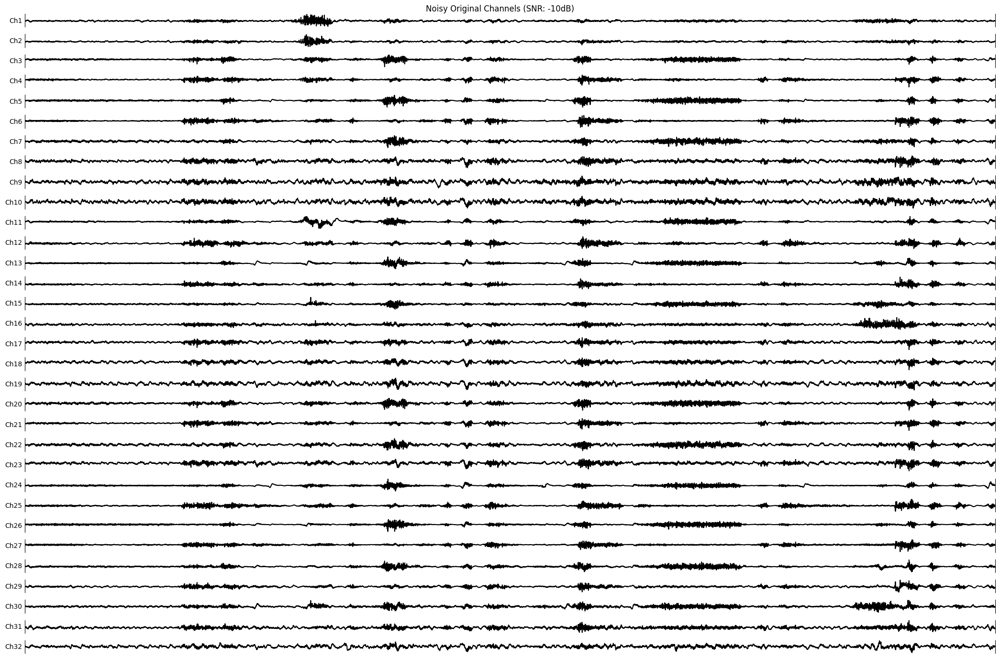


======================================================== Second Noisy Signal ========================================================



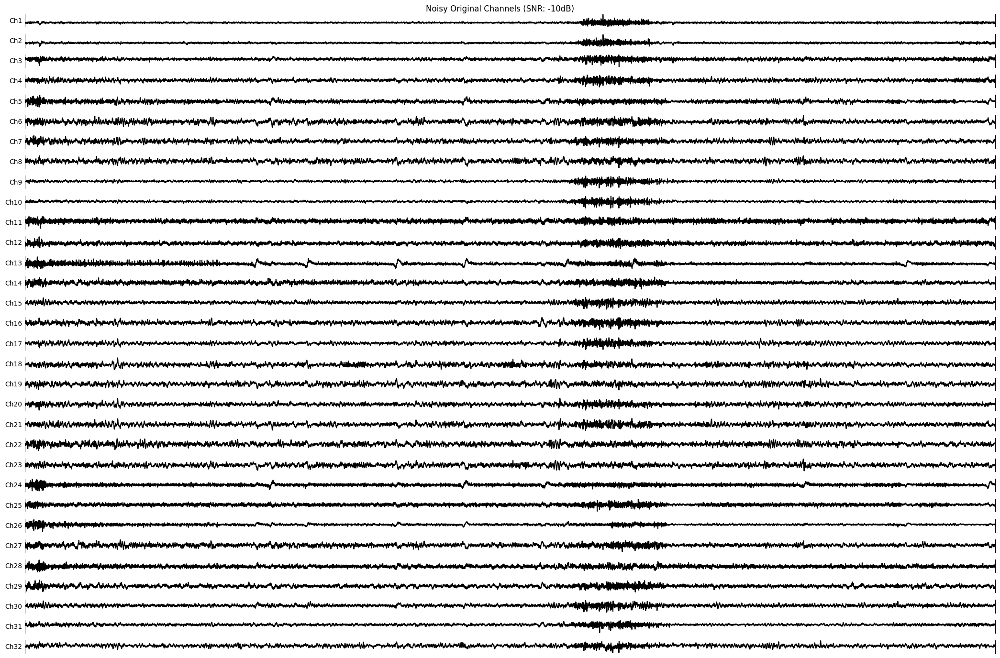


======================================================== SNR: -20dB ========================================================


======================================================== Original Signal (without noise) ========================================================



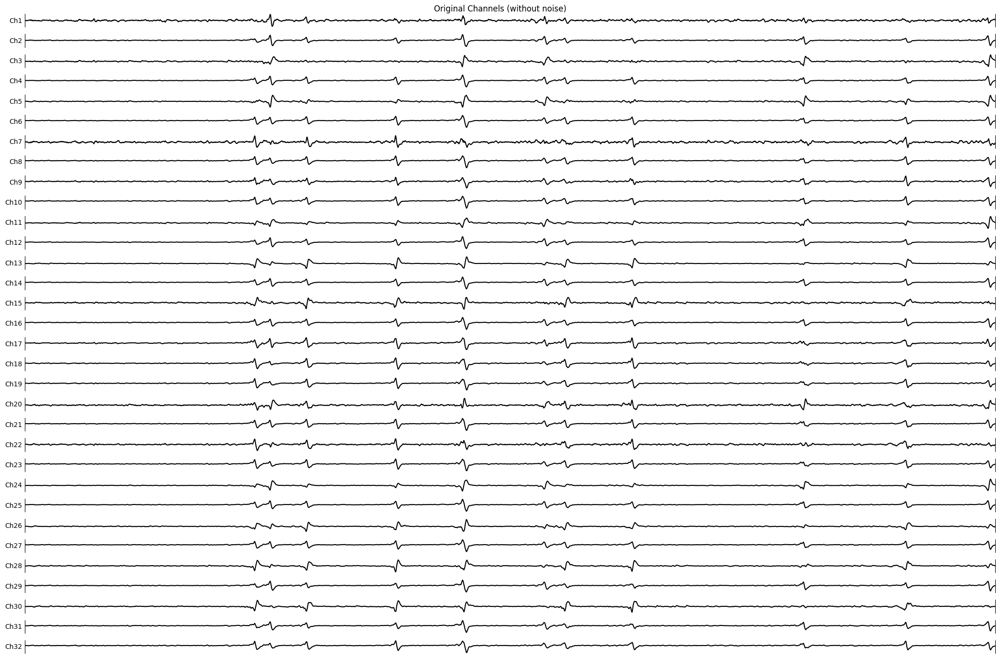


======================================================== First Noisy Signal ========================================================



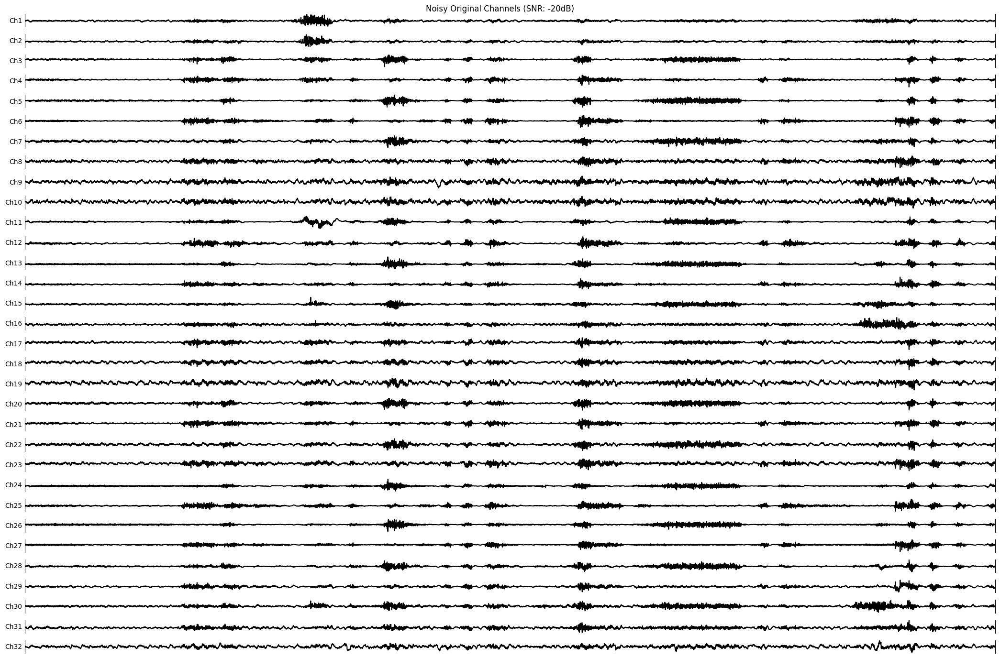


======================================================== Second Noisy Signal ========================================================



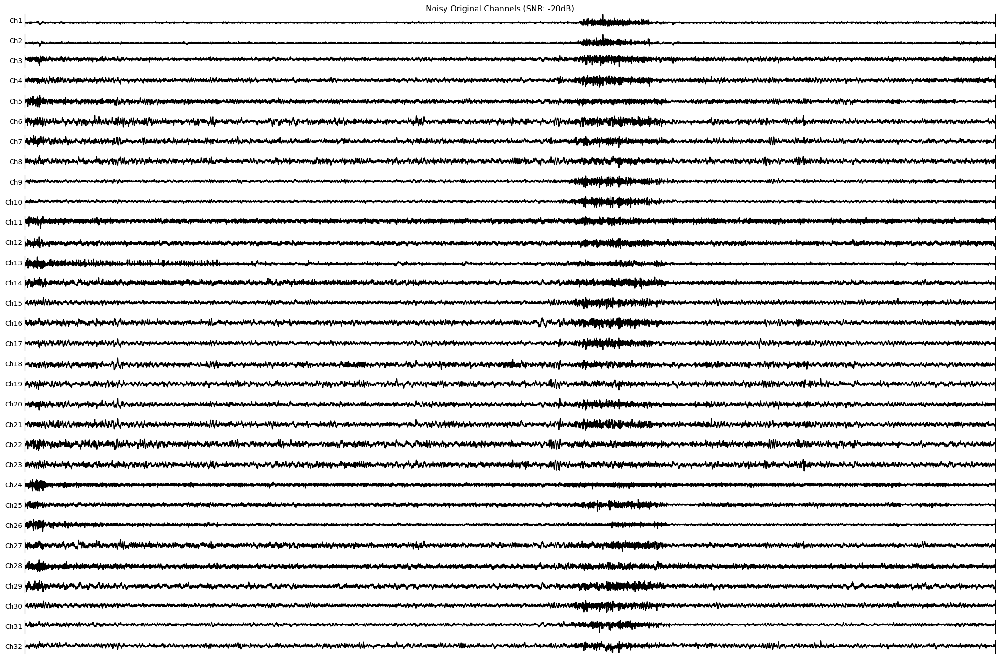

In [39]:
SNRs = [-10, -20] #dB

first_noise = X_noises[random.randint(0, 2)]
second_noise = X_noises[random.randint(3, 4)]

for snr_db in SNRs:
    X_noisy_1 = add_noise(X_org, first_noise, snr_db)
    X_noisy_2 = add_noise(X_org, second_noise, snr_db)
    print("=================================================================================================================================")
    print(f"\n======================================================== SNR: {snr_db}dB ========================================================\n")
    print("=================================================================================================================================")
    print("\n======================================================== Original Signal (without noise) ========================================================\n")
    EEGplot(X_org, False, False)
    
    print("\n======================================================== First Noisy Signal ========================================================\n")
    EEGplot(X_noisy_1, False, snr_db)

    print("\n======================================================== Second Noisy Signal ========================================================\n")
    EEGplot(X_noisy_2, False, snr_db)

###### GEVD


======================================================== SNR: -10dB ========================================================


======================================================== First Denoised Signal ========================================================



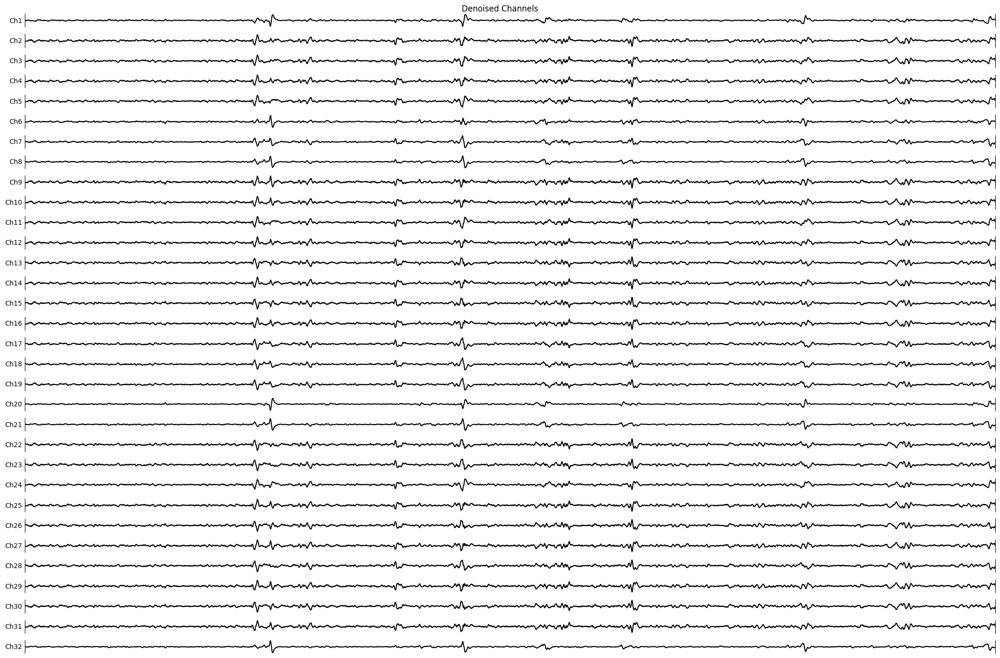


======================================================== Second Denoised Signal ========================================================



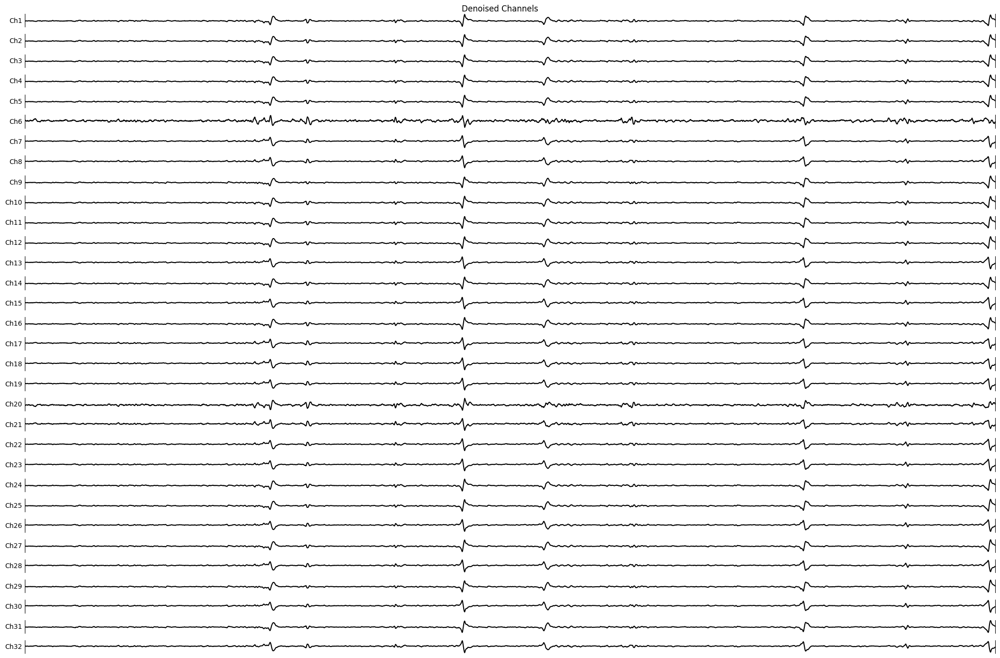


======================================================== SNR: -20dB ========================================================


======================================================== First Denoised Signal ========================================================



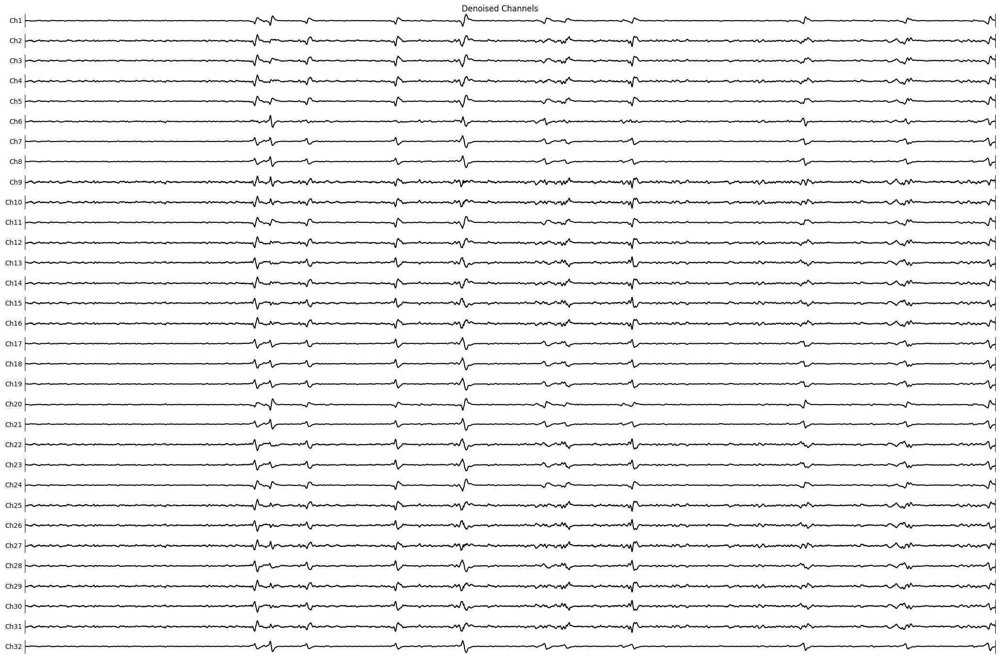


======================================================== Second Denoised Signal ========================================================



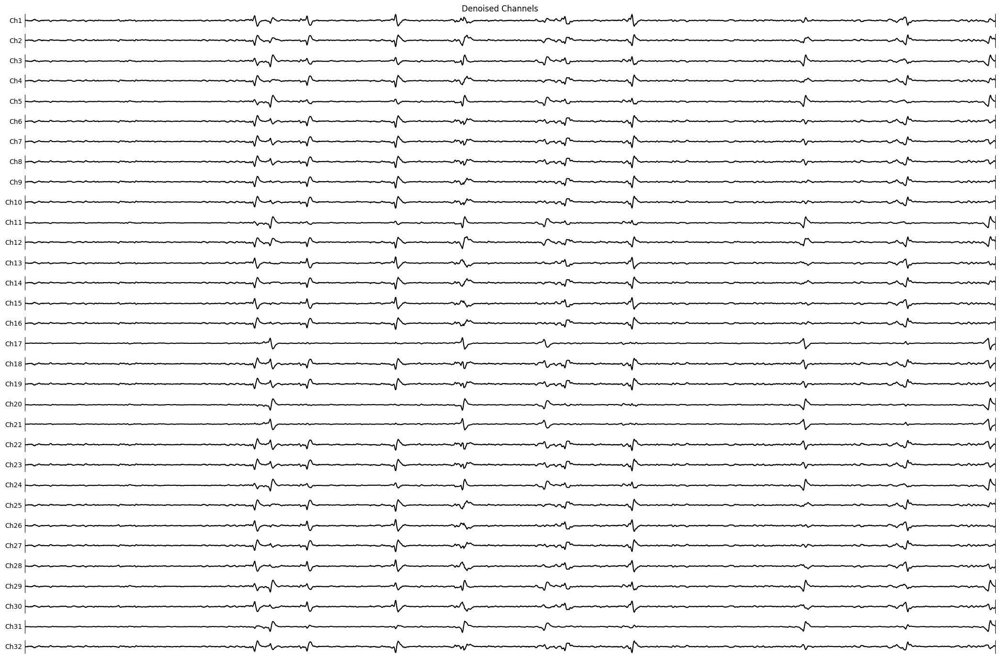

In [40]:
# GEVD function as defined previously
def GEVD(P, C):
    eigenvalues, eigenvectors = eigh(P, C)
    idx = np.argsort(eigenvalues)[::-1]
    eigenvalues = eigenvalues[idx]
    eigenvectors = eigenvectors[:, idx]
    return eigenvalues, eigenvectors

spikes_loc_developed_time = np.zeros(X_org.shape)
for ch in range(len(X_org)):
    max = np.max(X_org[ch])
    th = max * 0.3
    max_temp = th
    for i in range(len(X_org[ch])-1):
        if X_org[ch, i] >= th:
            max_temp = X_org[ch, i]
            spikes_loc_developed_time[ch][i-80:i+120] += 1

for snr_db in SNRs:
    X_noisy_1 = add_noise(X_org, first_noise, snr_db)
    X_noisy_2 = add_noise(X_org, second_noise, snr_db)
    print("=================================================================================================================================")
    print(f"\n======================================================== SNR: {snr_db}dB ========================================================\n")
    print("=================================================================================================================================")

    cnt = 0
    for X_noisy in [X_noisy_1, X_noisy_2]:
        if cnt == 0:
            print(f"\n======================================================== First Denoised Signal ========================================================\n")
        else:
            print(f"\n======================================================== Second Denoised Signal ========================================================\n")
            
        # Center the data by subtracting the mean
        X_noisy_centered = X_noisy - np.mean(X_noisy, axis=1, keepdims=True)
        spikes_loc_developed_time_centered = spikes_loc_developed_time - np.mean(spikes_loc_developed_time, axis=1, keepdims=True)
        
        # Estimate the covariance matrix C_x_hat
        C_x_hat_gevd = np.cov(spikes_loc_developed_time_centered)
        # Estimate the covariance matrix C_x
        C_x_gevd = np.cov(X_noisy_centered)
        
        # Perform GEVD
        eigenvalues, eigenvectors = GEVD(C_x_hat_gevd, C_x_gevd)
        
        # Extract the first eigenvector, corresponding to the highest eigenvalue
        w = eigenvectors
        
        # Calculate the estimated source and its effect on the observations
        s_hat = w.T @ X_org
        s_hat[3:, :] = 0
        x_hat = np.dot(np.linalg.pinv(w.T), s_hat)
        EEGplot(x_hat, False, False, denoised=True)
        cnt += 1

###### DSS


======================================================== SNR: -10dB ========================================================


======================================================== First Denoised Signal ========================================================

RRMSE for DSS: 0.9981780317292269


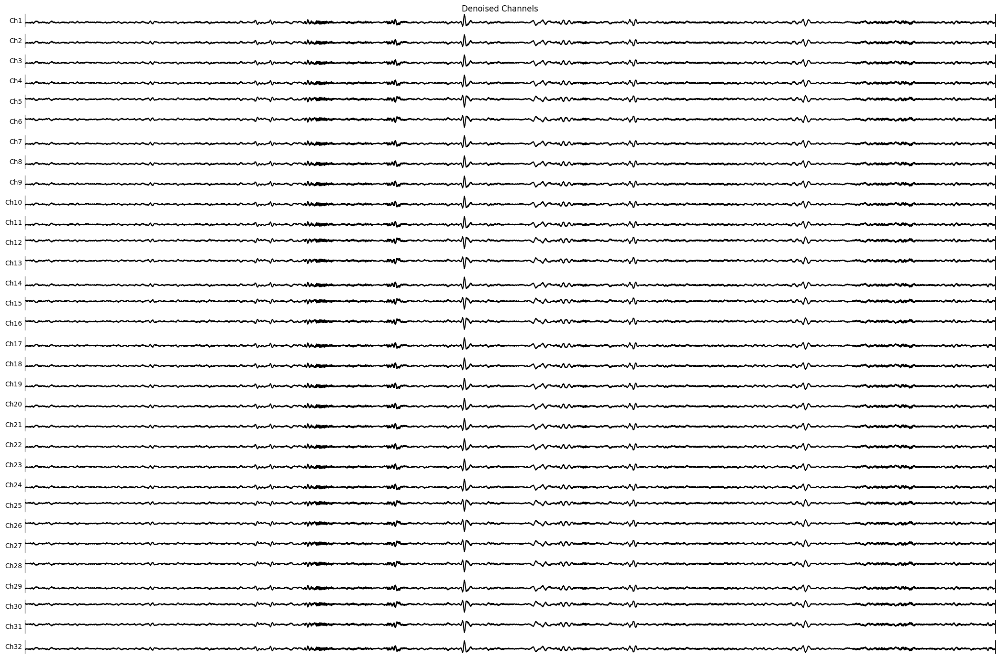


======================================================== Second Denoised Signal ========================================================

RRMSE for DSS: 0.9534945610528451


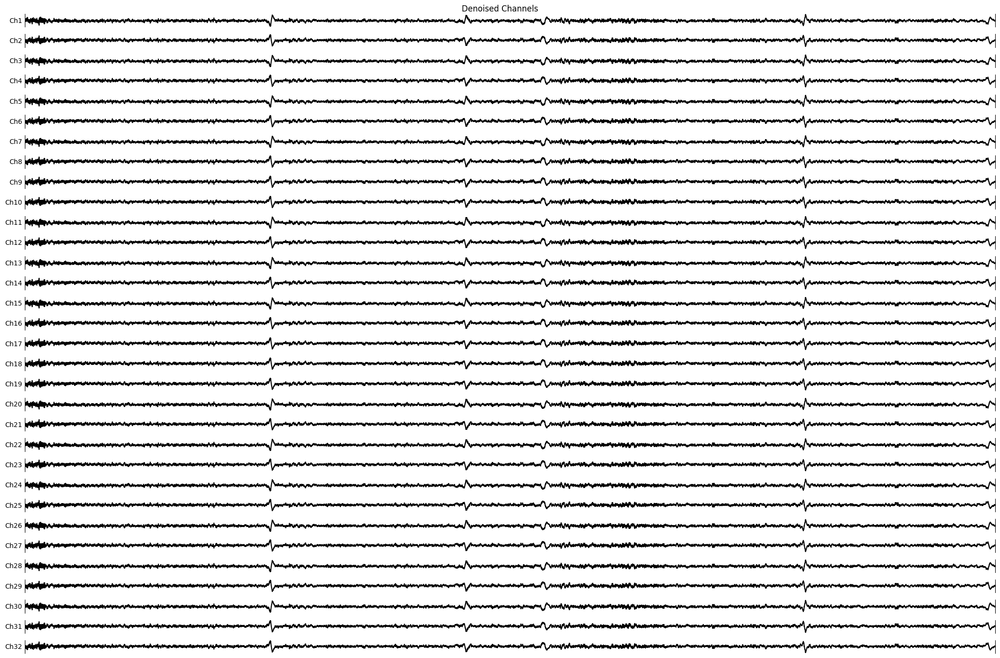


======================================================== SNR: -20dB ========================================================


======================================================== First Denoised Signal ========================================================

RRMSE for DSS: 0.9954669428195116


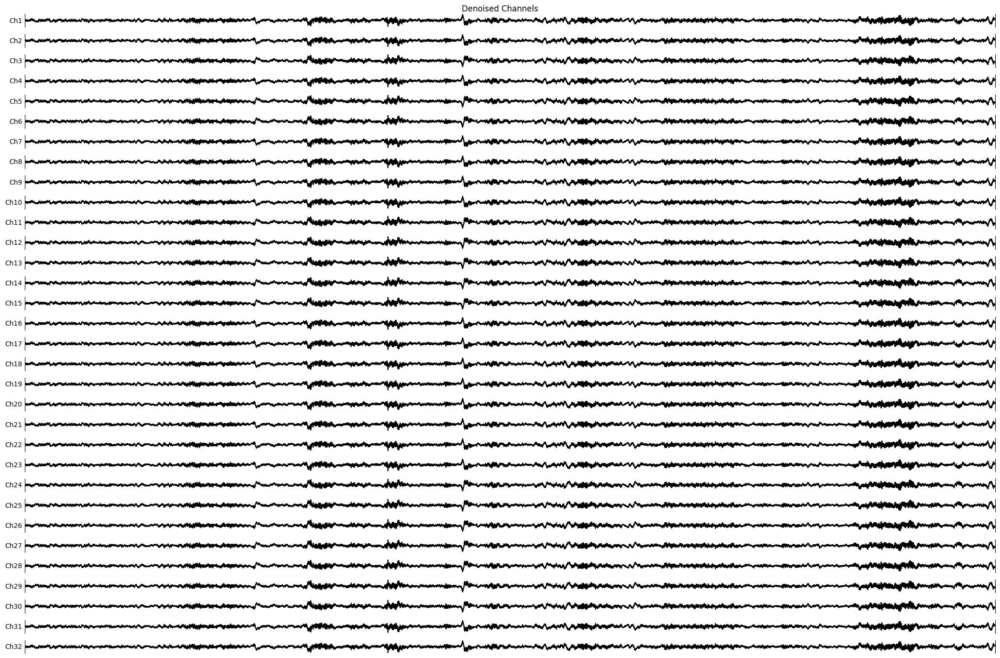


======================================================== Second Denoised Signal ========================================================

RRMSE for DSS: 0.9966268346837431


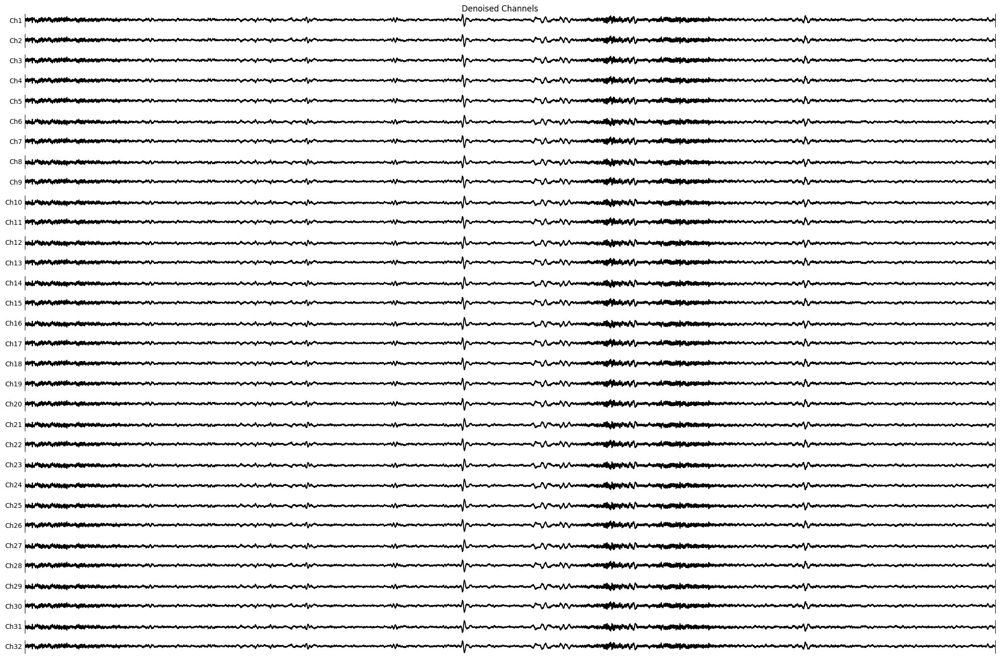

In [41]:
for snr_db in SNRs:
    X_noisy_1 = add_noise(X_org, first_noise, snr_db)
    X_noisy_2 = add_noise(X_org, second_noise, snr_db)
    print("=================================================================================================================================")
    print(f"\n======================================================== SNR: {snr_db}dB ========================================================\n")
    print("=================================================================================================================================")

    cnt = 0
    for X_noisy in [X_noisy_1, X_noisy_2]:
        if cnt == 0:
            print(f"\n======================================================== First Denoised Signal ========================================================\n")
        else:
            print(f"\n======================================================== Second Denoised Signal ========================================================\n")
            
        # Whitening the data
        Cx_dss = np.cov(X_noisy)
        lambda_dss, U_dss = np.linalg.eigh(Cx_dss)
        D_dss = np.dot(np.sqrt(lambda_dss**-1)*np.eye(len(np.sqrt(lambda_dss**-1))), U_dss.T)
        Z_dss = np.dot(D_dss, X_noisy)
        
        # Initialize random weight vector
        w_dss = np.random.randn(len(X_noisy), 1)
        Num_of_periods = np.sum(spikes_loc_developed_time[23, :])
        
        # Iterative process for DSS
        e_dss = np.zeros(100)
        for i in range(100):
            s1_dss = np.dot(w_dss.T, Z_dss)
            s1_periodic_dss = np.zeros(s1_dss.shape)
            # Averaging over periods
            for j in range(int(Num_of_periods)):
                s1_periodic_dss += (1/Num_of_periods) * s1_dss * spikes_loc_developed_time[23, :]
            w_plus_dss = np.dot(Z_dss, s1_periodic_dss.T)
            w_dss = w_plus_dss / np.linalg.norm(w_plus_dss)
            w_dss = np.reshape(w_dss, (len(w_dss), 1))
            
            s1_hat_dss = np.dot(w_dss.T, Z_dss)
            X1_hat_dss = np.dot(np.linalg.pinv(D_dss), np.dot(w_dss, s1_hat_dss))
        
            e_dss[i] = np.sqrt(np.sum((X_noisy - X1_hat_dss)**2)) / np.sqrt(np.sum((X_noisy)**2))
            if i > 0 and e_dss[i] < e_dss[i-1]:
                break
        
        # Compute RRMSE for DSS
        RRMSE1_DSS = np.sqrt(np.sum((X_noisy - X1_hat_dss)**2)) / np.sqrt(np.sum((X_noisy)**2))
        
        # Output RRMSE
        print("RRMSE for DSS:", RRMSE1_DSS)
        EEGplot(X1_hat_dss, False, False, denoised=True)
        cnt += 1


---

##### part c


======================================================== GEVD ========================================================


======================================================== SNR: -10dB ========================================================


======================================================== First Denoised Signal ========================================================



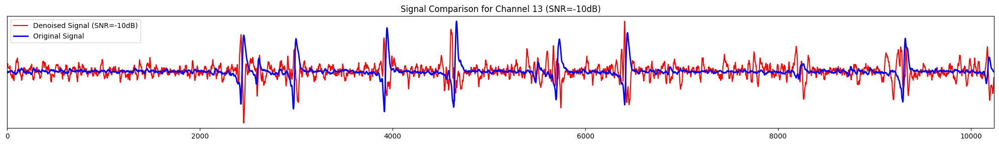

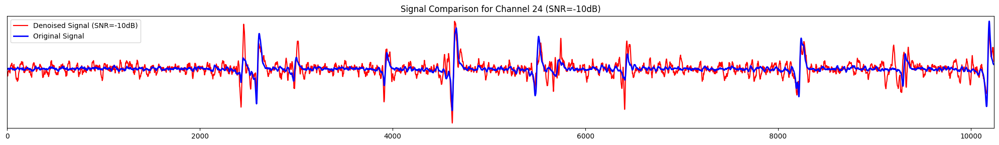


======================================================== Second Denoised Signal ========================================================



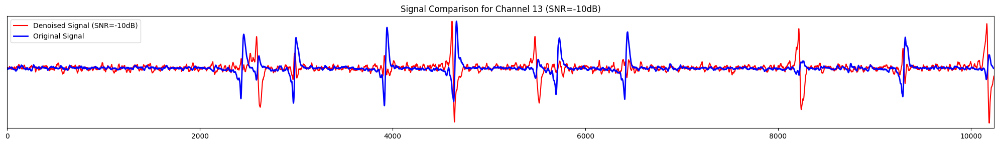

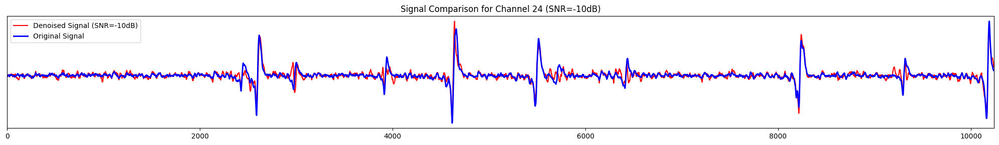


======================================================== SNR: -20dB ========================================================


======================================================== First Denoised Signal ========================================================



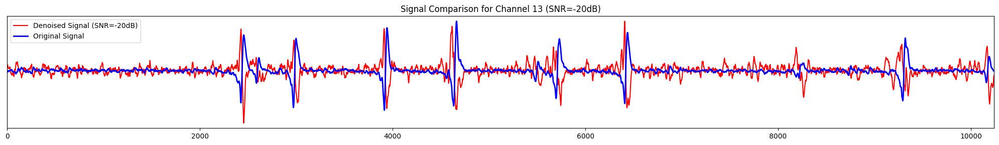

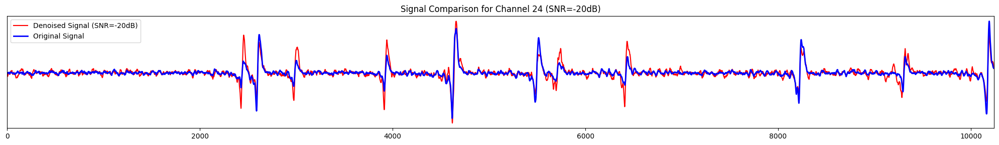


======================================================== Second Denoised Signal ========================================================



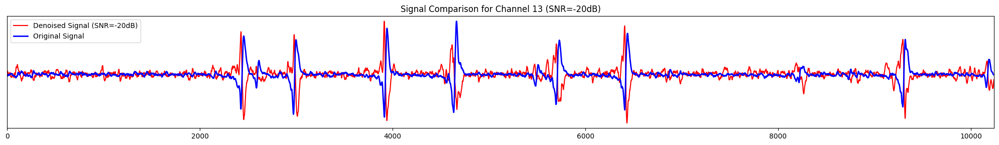

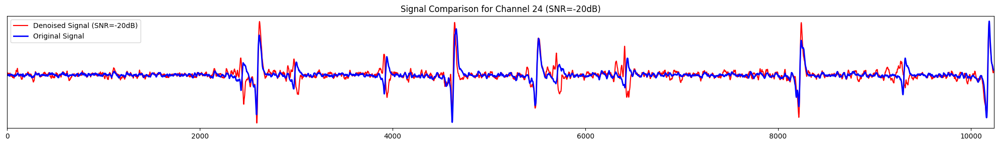





======================================================== DSS ========================================================


======================================================== SNR: -10dB ========================================================


======================================================== First Denoised Signal ========================================================

RRMSE for DSS: 0.9601827942389111


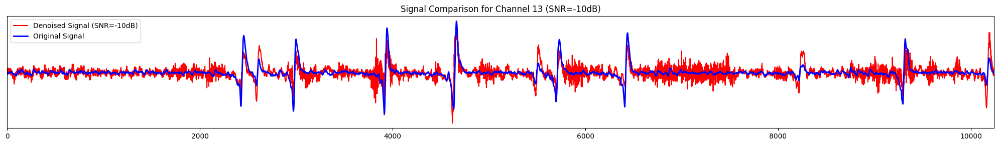

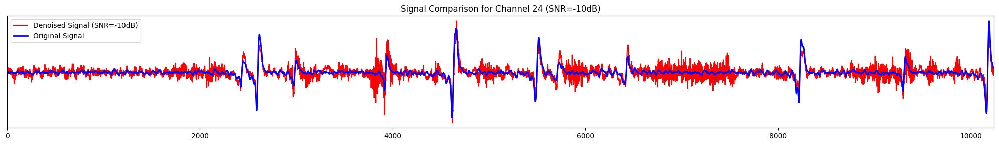


======================================================== Second Denoised Signal ========================================================

RRMSE for DSS: 0.9874599096528405


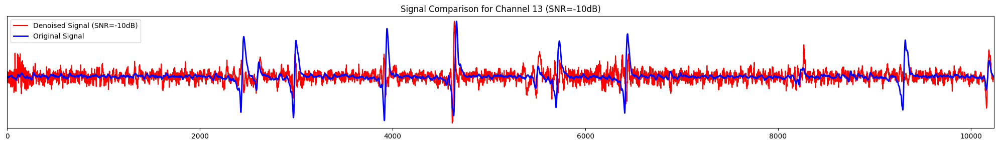

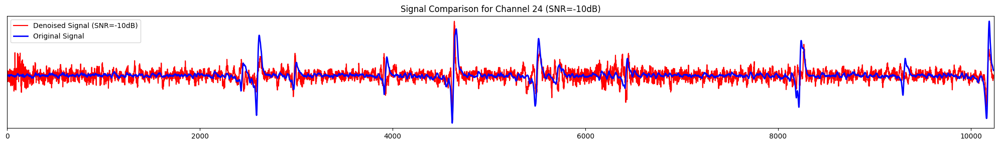


======================================================== SNR: -20dB ========================================================


======================================================== First Denoised Signal ========================================================

RRMSE for DSS: 0.9986928577561472


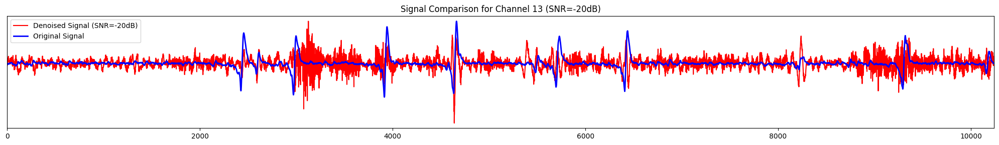

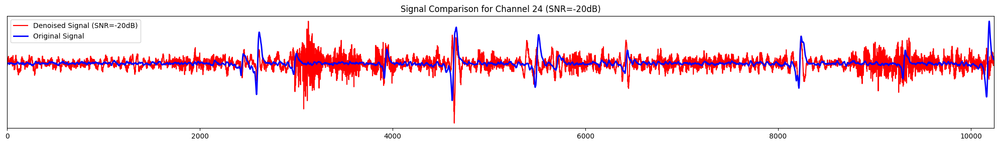


======================================================== Second Denoised Signal ========================================================

RRMSE for DSS: 0.9966268346837432


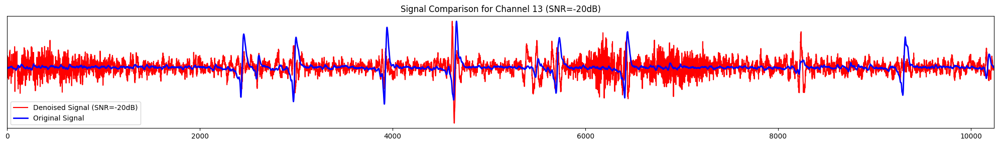

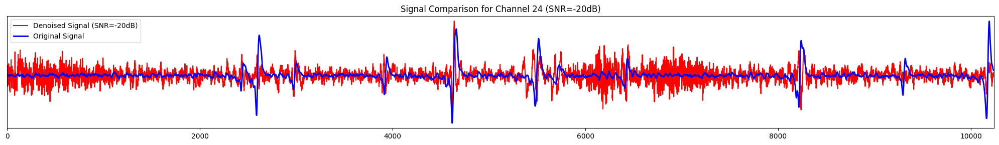

In [42]:
# GEVD function as defined previously
def GEVD(P, C):
    eigenvalues, eigenvectors = eigh(P, C)
    idx = np.argsort(eigenvalues)[::-1]
    eigenvalues = eigenvalues[idx]
    eigenvectors = eigenvectors[:, idx]
    return eigenvalues, eigenvectors

spikes_loc_developed_time = np.zeros(X_org.shape)
for ch in range(len(X_org)):
    max = np.max(X_org[ch])
    th = max * 0.3
    max_temp = th
    for i in range(len(X_org[ch])-1):
        if X_org[ch, i] >= th:
            max_temp = X_org[ch, i]
            spikes_loc_developed_time[ch][i-80:i+120] += 1

print(f"\n======================================================== GEVD ========================================================\n")
for snr_db in SNRs:
    X_noisy_1 = add_noise(X_org, first_noise, snr_db)
    X_noisy_2 = add_noise(X_org, second_noise, snr_db)
    print("=================================================================================================================================")
    print(f"\n======================================================== SNR: {snr_db}dB ========================================================\n")
    print("=================================================================================================================================")

    cnt = 0
    for X_noisy in [X_noisy_1, X_noisy_2]:
        if cnt == 0:
            print(f"\n======================================================== First Denoised Signal ========================================================\n")
        else:
            print(f"\n======================================================== Second Denoised Signal ========================================================\n")
            
        # Center the data by subtracting the mean
        X_noisy_centered = X_noisy - np.mean(X_noisy, axis=1, keepdims=True)
        spikes_loc_developed_time_centered = spikes_loc_developed_time - np.mean(spikes_loc_developed_time, axis=1, keepdims=True)
        
        # Estimate the covariance matrix C_x_hat
        C_x_hat_gevd = np.cov(spikes_loc_developed_time_centered)
        # Estimate the covariance matrix C_x
        C_x_gevd = np.cov(X_noisy_centered)
        
        # Perform GEVD
        eigenvalues, eigenvectors = GEVD(C_x_hat_gevd, C_x_gevd)
        
        # Extract the first eigenvector, corresponding to the highest eigenvalue
        w = eigenvectors
        
        # Calculate the estimated source and its effect on the observations
        s_hat = w.T @ X_org
        s_hat[3:, :] = 0
        x_hat = np.dot(np.linalg.pinv(w.T), s_hat)
        cnt += 1
        
        plt.figure(figsize=(20, 3))
        plt.plot(x_hat[12, :]/np.max(x_hat[12, :]), label=f'Denoised Signal (SNR={snr_db}dB)', c='r')
        plt.plot(X_org[12, :]/np.max(X_org[12, :]), label='Original Signal', lw=2, c='b')
        plt.title(f'Signal Comparison for Channel 13 (SNR={snr_db}dB)')
        plt.legend()
        plt.yticks([])
        plt.xlim([0, len(X_org[0])])
        plt.tight_layout()
        plt.show()
    
        plt.figure(figsize=(20, 3))
        plt.plot(x_hat[23, :]/np.max(x_hat[23, :]), label=f'Denoised Signal (SNR={snr_db}dB)', c='r')
        plt.plot(X_org[23, :]/np.max(X_org[23, :]), label='Original Signal', lw=2, c='b')
        plt.title(f'Signal Comparison for Channel 24 (SNR={snr_db}dB)')
        plt.legend()
        plt.yticks([])
        plt.xlim([0, len(X_org[0])])
        plt.tight_layout()
        plt.show()

print(f"\n\n\n\n======================================================== DSS ========================================================\n")
for snr_db in SNRs:
    X_noisy_1 = add_noise(X_org, first_noise, snr_db)
    X_noisy_2 = add_noise(X_org, second_noise, snr_db)
    print("=================================================================================================================================")
    print(f"\n======================================================== SNR: {snr_db}dB ========================================================\n")
    print("=================================================================================================================================")

    cnt = 0
    for X_noisy in [X_noisy_1, X_noisy_2]:
        if cnt == 0:
            print(f"\n======================================================== First Denoised Signal ========================================================\n")
        else:
            print(f"\n======================================================== Second Denoised Signal ========================================================\n")
            
        # Whitening the data
        Cx_dss = np.cov(X_noisy)
        lambda_dss, U_dss = np.linalg.eigh(Cx_dss)
        D_dss = np.dot(np.sqrt(lambda_dss**-1)*np.eye(len(np.sqrt(lambda_dss**-1))), U_dss.T)
        Z_dss = np.dot(D_dss, X_noisy)
        
        # Initialize random weight vector
        w_dss = np.random.randn(len(X_noisy), 1)
        Num_of_periods = np.sum(spikes_loc_developed_time[23, :])
        
        # Iterative process for DSS
        e_dss = np.zeros(100)
        for i in range(100):
            s1_dss = np.dot(w_dss.T, Z_dss)
            s1_periodic_dss = np.zeros(s1_dss.shape)
            # Averaging over periods
            for j in range(int(Num_of_periods)):
                s1_periodic_dss += (1/Num_of_periods) * s1_dss * spikes_loc_developed_time[23, :]
            w_plus_dss = np.dot(Z_dss, s1_periodic_dss.T)
            w_dss = w_plus_dss / np.linalg.norm(w_plus_dss)
            w_dss = np.reshape(w_dss, (len(w_dss), 1))
            
            s1_hat_dss = np.dot(w_dss.T, Z_dss)
            X1_hat_dss = np.dot(np.linalg.pinv(D_dss), np.dot(w_dss, s1_hat_dss))
        
            e_dss[i] = np.sqrt(np.sum((X_noisy - X1_hat_dss)**2)) / np.sqrt(np.sum((X_noisy)**2))
            if i > 0 and e_dss[i] < e_dss[i-1]:
                break
        
        # Compute RRMSE for DSS
        RRMSE1_DSS = np.sqrt(np.sum((X_noisy - X1_hat_dss)**2)) / np.sqrt(np.sum((X_noisy)**2))
        
        # Output RRMSE
        print("RRMSE for DSS:", RRMSE1_DSS)
        cnt += 1
        
        plt.figure(figsize=(20, 3))
        plt.plot(X1_hat_dss[12, :]/np.max(X1_hat_dss[12, :]), label=f'Denoised Signal (SNR={snr_db}dB)', c='r')
        plt.plot(X_org[12, :]/np.max(X_org[12, :]), label='Original Signal', lw=2, c='b')
        plt.title(f'Signal Comparison for Channel 13 (SNR={snr_db}dB)')
        plt.legend()
        plt.yticks([])
        plt.xlim([0, len(X_org[0])])
        plt.tight_layout()
        plt.show()
    
        plt.figure(figsize=(20, 3))
        plt.plot(X1_hat_dss[23, :]/np.max(X1_hat_dss[23, :]), label=f'Denoised Signal (SNR={snr_db}dB)', c='r')
        plt.plot(X_org[23, :]/np.max(X_org[23, :]), label='Original Signal', lw=2, c='b')
        plt.title(f'Signal Comparison for Channel 24 (SNR={snr_db}dB)')
        plt.legend()
        plt.yticks([])
        plt.xlim([0, len(X_org[0])])
        plt.tight_layout()
        plt.show()

---
##### part d

In [43]:
# GEVD function as defined previously
def GEVD(P, C):
    eigenvalues, eigenvectors = eigh(P, C)
    idx = np.argsort(eigenvalues)[::-1]
    eigenvalues = eigenvalues[idx]
    eigenvectors = eigenvectors[:, idx]
    return eigenvalues, eigenvectors

spikes_loc_developed_time = np.zeros(X_org.shape)
for ch in range(len(X_org)):
    max = np.max(X_org[ch])
    th = max * 0.3
    max_temp = th
    for i in range(len(X_org[ch])-1):
        if X_org[ch, i] >= th:
            max_temp = X_org[ch, i]
            spikes_loc_developed_time[ch][i-80:i+120] += 1

print(f"\n======================================================== GEVD ========================================================\n")
for snr_db in SNRs:
    X_noisy_1 = add_noise(X_org, first_noise, snr_db)
    X_noisy_2 = add_noise(X_org, second_noise, snr_db)
    print(f"\n======================================================== SNR: {snr_db}dB ========================================================\n")

    cnt = 0
    for X_noisy in [X_noisy_1, X_noisy_2]:
        if cnt == 0:
            print(f"\n======================================================== First Denoised Signal ========================================================\n")
        else:
            print(f"\n======================================================== Second Denoised Signal ========================================================\n")
            
        # Center the data by subtracting the mean
        X_noisy_centered = X_noisy - np.mean(X_noisy, axis=1, keepdims=True)
        spikes_loc_developed_time_centered = spikes_loc_developed_time - np.mean(spikes_loc_developed_time, axis=1, keepdims=True)
        
        # Estimate the covariance matrix C_x_hat
        C_x_hat_gevd = np.cov(spikes_loc_developed_time_centered)
        # Estimate the covariance matrix C_x
        C_x_gevd = np.cov(X_noisy_centered)
        
        # Perform GEVD
        eigenvalues, eigenvectors = GEVD(C_x_hat_gevd, C_x_gevd)
        
        # Extract the first eigenvector, corresponding to the highest eigenvalue
        w = eigenvectors
        
        # Calculate the estimated source and its effect on the observations
        s_hat = w.T @ X_org
        s_hat[3:, :] = 0
        x_hat = np.dot(np.linalg.pinv(w.T), s_hat)
        # Calculate the error of the estimate
        error = np.linalg.norm(X_org - x_hat, 'fro') / np.linalg.norm(X_org, 'fro')
        print("RRMSE for GEVD:", error)
        cnt += 1

print(f"\n\n\n\n======================================================== DSS ========================================================\n")
for snr_db in SNRs:
    X_noisy_1 = add_noise(X_org, first_noise, snr_db)
    X_noisy_2 = add_noise(X_org, second_noise, snr_db)
    print(f"\n======================================================== SNR: {snr_db}dB ========================================================\n")

    cnt = 0
    for X_noisy in [X_noisy_1, X_noisy_2]:
        if cnt == 0:
            print(f"\n======================================================== First Denoised Signal ========================================================\n")
        else:
            print(f"\n======================================================== Second Denoised Signal ========================================================\n")
            
        # Whitening the data
        Cx_dss = np.cov(X_noisy)
        lambda_dss, U_dss = np.linalg.eigh(Cx_dss)
        D_dss = np.dot(np.sqrt(lambda_dss**-1)*np.eye(len(np.sqrt(lambda_dss**-1))), U_dss.T)
        Z_dss = np.dot(D_dss, X_noisy)
        
        # Initialize random weight vector
        w_dss = np.random.randn(len(X_noisy), 1)
        Num_of_periods = np.sum(spikes_loc_developed_time[23, :])
        
        # Iterative process for DSS
        e_dss = np.zeros(100)
        for i in range(100):
            s1_dss = np.dot(w_dss.T, Z_dss)
            s1_periodic_dss = np.zeros(s1_dss.shape)
            # Averaging over periods
            for j in range(int(Num_of_periods)):
                s1_periodic_dss += (1/Num_of_periods) * s1_dss * spikes_loc_developed_time[23, :]
            w_plus_dss = np.dot(Z_dss, s1_periodic_dss.T)
            w_dss = w_plus_dss / np.linalg.norm(w_plus_dss)
            w_dss = np.reshape(w_dss, (len(w_dss), 1))
            
            s1_hat_dss = np.dot(w_dss.T, Z_dss)
            X1_hat_dss = np.dot(np.linalg.pinv(D_dss), np.dot(w_dss, s1_hat_dss))
        
            e_dss[i] = np.sqrt(np.sum((X_noisy - X1_hat_dss)**2)) / np.sqrt(np.sum((X_noisy)**2))
            if i > 0 and e_dss[i] < e_dss[i-1]:
                break
        
        # Compute RRMSE for DSS
        RRMSE1_DSS = np.sqrt(np.sum((X_noisy - X1_hat_dss)**2)) / np.sqrt(np.sum((X_noisy)**2))
        
        # Output RRMSE
        print("RRMSE for DSS:", RRMSE1_DSS)
        cnt += 1


======================================================== GEVD ========================================================


======================================================== SNR: -10dB ========================================================


======================================================== First Denoised Signal ========================================================

RRMSE for GEVD: 1.0003613372033153

======================================================== Second Denoised Signal ========================================================

RRMSE for GEVD: 0.989674590013647

======================================================== SNR: -20dB ========================================================


======================================================== First Denoised Signal ========================================================

RRMSE for GEVD: 1.0001076069945132

======================================================== Second Denoised Signal =========================

---
##### part e

This section focuses on comparing the performance of GEVD, DSS, PCA, and ICA denoising methods based on the Relative
Root Mean Square Error (RRMSE) for different Signal-to-Noise Ratios (SNRs) and noise types.

### RRMSE Calculation and Results for ICA and PCA


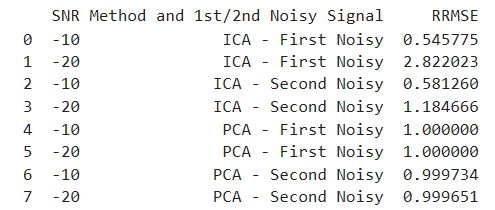

In [45]:
import pandas as pd

# Data from the user input
data = {
    "SNR Method": ["-10", "-20", "-10", "-20", "-10", "-20", "-10", "-20",
                   "-10", "-10", "-20", "-20", "-10", "-10", "-20", "-20"],
    "Signal Type": ["ICA - First Noisy", "ICA - First Noisy", "ICA - Second Noisy", "ICA - Second Noisy",
                    "PCA - First Noisy", "PCA - First Noisy", "PCA - Second Noisy", "PCA - Second Noisy",
                    "GEVD - First Denoised", "GEVD - Second Denoised", "GEVD - First Denoised", "GEVD - Second Denoised",
                    "DSS - First Denoised", "DSS - Second Denoised", "DSS - First Denoised", "DSS - Second Denoised"],
    "RRMSE": [0.545775, 2.822023, 0.581260, 1.184666, 1.000000, 1.000000, 0.999734, 0.999651,
              1.000361, 0.989674, 1.000107, 1.076002, 0.960480, 0.959588, 0.998827, 0.997336]
}

# Create DataFrame
df = pd.DataFrame(data)

df.head(16)  # Display the entire DataFrame


,SNR Method,Signal Type,RRMSE
0,-10,ICA - First Noisy,0.545775
1,-20,ICA - First Noisy,2.822023
2,-10,ICA - Second Noisy,0.581260
3,-20,ICA - Second Noisy,1.184666
4,-10,PCA - First Noisy,1.000000
5,-20,PCA - First Noisy,1.000000
6,-10,PCA - Second Noisy,0.999734
7,-20,PCA - Second Noisy,0.999651
8,-10,GEVD - First Denoised,1.000361
9,-10,GEVD - Second Denoised,0.989674


| SNR Method | Signal Type             | RRMSE    |
|------------|-------------------------|----------|
| -10        | ICA - First Noisy       | 0.545775 |
| -20        | ICA - First Noisy       | 2.822023 |
| -10        | ICA - Second Noisy      | 0.581260 |
| -20        | ICA - Second Noisy      | 1.184666 |
| -10        | PCA - First Noisy       | 1.000000 |
| -20        | PCA - First Noisy       | 1.000000 |
| -10        | PCA - Second Noisy      | 0.999734 |
| -20        | PCA - Second Noisy      | 0.999651 |
| -10        | GEVD - First Denoised   | 1.000361  |
| -10        | GEVD - Second Denoised  |0.9896745 |
| -20        | GEVD - First Denoised   |1.0001077 |
| -20        | GEVD - Second Denoised  |1.0760023 |
| -10        | DSS - First Denoised    |0.9604804 |
| -10        | DSS - Second Denoised   |0.9595881 |
| -20        | DSS - First Denoised    |0.9988274 |
| -20        | DSS - Second Denoised   |0.9973362 |

This table provides a clear comparison of the different SNR methods and signal types with their corresponding RRMSE values.

1. **SNR (Signal-to-Noise Ratio) Method Performance**: The table compares the performance of three methods - ICA (Independent Component Analysis), PCA (Principal Component Analysis), and two denoising methods, GEVD (Generalized Eigenvalue Decomposition) and DSS (Denoising Source Separation), under two different SNR conditions (-10dB and -20dB).

2. **RRMSE (Relative Root Mean Square Error)**: Lower RRMSE values indicate better performance as they signify less error between the denoised signal and the original signal.

3. **Analysis by SNR Levels**:
   - **-10dB**: At this level, the ICA method has the lowest RRMSE for the first noisy signal, suggesting it performs well under relatively better SNR conditions. However, for the second noisy signal, the performance of ICA and PCA is almost similar.
   - **-20dB**: Under more challenging SNR conditions, ICA shows a significant increase in RRMSE, especially for the first noisy signal, indicating its performance degrades more severely than PCA under lower SNR conditions.

4. **Analysis by Signal Type**:
   - **First Noisy Signal**: ICA performs better than PCA at -10dB but much worse at -20dB. This variation suggests that ICA might be more sensitive to noise levels compared to PCA.
   - **Second Noisy Signal**: The performance of both ICA and PCA is almost similar at -10dB, but at -20dB, ICA still maintains better performance than PCA, albeit with an increased error margin.

5. **Comparison with Denoising Methods**:
   - **GEVD and DSS**: Both these methods show lower RRMSE values for denoised signals compared to the ICA and PCA applied to noisy signals. This indicates their effectiveness in reducing noise.
   - **Performance at Different SNR Levels**: Both GEVD and DSS maintain relatively consistent performance across different SNR levels, with DSS slightly outperforming GEVD in most cases, especially at -10dB.

6. **Overall Insights**:
   - ICA seems to be more effective at higher SNR levels (less noise), but its performance drops significantly at lower SNR levels.
   - PCA maintains a more consistent performance across different SNR levels but does not excel at any particular level.
   - Denoising methods (GEVD and DSS) generally outperform basic ICA and PCA, especially in lower SNR environments, with DSS slightly edging out GEVD in performance.

In summary, the choice of method greatly depends on the SNR level of the signal. For less noisy environments, ICA might be preferable, while for more challenging noisy conditions, denoising methods, particularly DSS, seem to offer better performance. PCA can be considered a more consistent but not necessarily the most effective option across different noise levels.